# Learning with minibatch Wasserstein : asymptotic and gradient properties

The most crucial aspect is to conduct a detailed numerical study, focusing on simple examples (such as in 1D and 2D) to determine how the bias (typically from the gradient of the functional) decreases with increasing batch sizes. In my opinion, there's no need to address a real machine learning problem (like generative models) since it would be challenging to assess precisely. However, if you have the time, we can explore it towards the end. Instead, we can conduct non-parametric tests: minimize the distance between a set of points using mini-batch processing against another set and analyze the convergence direction to understand the bias impact on the optimization problem solution. An intriguing question would be to also see how this pans out in dimensions higher than 1 or 2.
However, be cautious: if you directly minimize the Sinkhorn cost $W_ϵ(a,b)$, an additional bias due to entropy will come into play. To eliminate it, you can consider the debiased divergence:
$W_ϵ(a,b) - \frac{W_ϵ(a,a)}{2} - \frac{W_ϵ(b,b)}{2}$


In [ ]:
%pip install pot
import ot

In [ ]:
#----- IMPORT -----
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pylab as pl

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable, grad
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms

import time
from random import choices
from scipy import misc
from time import time
from scipy.special import comb
from itertools import combinations, permutations
from scipy.special import logsumexp

from sklearn.metrics.pairwise import cosine_similarity

import cvxpy as cp
from tqdm import tqdm

from sklearn.datasets import make_moons, make_swiss_roll

use_cuda = torch.cuda.is_available()
device = 'cuda' if use_cuda else 'cpu'

# Utils functions

In this section one can find utils functions to plot distributions, get data, mini batch...

In [ ]:
def uniform_dist(n, d):
  '''
  Sample two uniform distributions between 0 and 1 with n points and d dimensions
  Inputs:
    n: number of points
    d: dimension
  Returns:
    alpha, beta
  '''
  alpha = np.random.uniform(0, 1, size=(n, d))
  beta = np.random.uniform(0, 1, size=(n, d))
  return alpha, beta

In [ ]:
def mini_batch(alpha, m):
  # Return a minibatch of size m of alpha (n, d)
  n = len(alpha)
  idx = np.random.choice(np.arange(n), size=m, replace=False)
  mb_alpha = alpha[np.ix_(idx)]
  return mb_alpha, idx

In [ ]:
def mini_batch_tensor(alpha, m):
  n = alpha.size(0)
  idx = torch.randperm(n)[:m]
  mb_alpha = alpha[idx]
  return mb_alpha, idx

In [ ]:
def get_mbtp(alpha, beta, m, h='entropic'):
  '''
  Get the exacft mini batch transport plan between alpha (n, d) and beta (n, d) with mini batch size of m
  h: "emd" (Wasserstein distance), "entropic" (Entropic loss), "sinkhorn" (Debiased sinkhorn)
  '''
  n = len(alpha)
  mbtp = np.zeros((n, n))
  count = 0
  for idx_a in combinations(range(n), m):
    for idx_b in combinations(range(n), m):
      mb_a = alpha[np.ix_(idx_a)]
      mb_b = beta[np.ix_(idx_b)]
      if h == 'emd':
        mbtp_sub = ot.emd([], [], ot.dist(mb_a, mb_b))
      elif h == 'entropic':
        mbtp_sub = ot.sinkhorn([], [], ot.dist(mb_a, mb_b), reg=1e-2)
      else:
        mbtp_sub = ot.sinkhorn([], [], ot.dist(mb_a, mb_b), reg=1e-2) - 0.5 * (ot.sinkhorn([], [], ot.dist(mb_a, mb_a), reg=1e-2) + ot.sinkhorn([], [], ot.dist(mb_b, mb_b), reg=1e-2))
      mbtp[np.ix_(idx_a, idx_b)] += mbtp_sub
      count += 1
  return mbtp / count

In [ ]:
def get_subsampled_mbtp(alpha, beta, m, k, h='entropic'):
  '''
  Get the subsampled mini batch transport plan between alpha (n, d) and beta (n, d) with mini batch size of m and k
  h: "emd" (Wasserstein distance), "entropic" (Entropic loss), "sinkhorn" (Debiased sinkhorn)
  '''
  n = len(alpha)
  mbtp = np.zeros((n, n))
  for _ in tqdm(range(k)):
    mb_a, idx_a = mini_batch(alpha, m)
    mb_b, idx_b = mini_batch(beta, m)
    if h == 'emd':
      mbtp_sub = ot.emd([], [], ot.dist(mb_a, mb_b))
    elif h == 'entropic':
      mbtp_sub = ot.sinkhorn([], [], ot.dist(mb_a, mb_b), reg=1e-2)
    else:
      mbtp_sub = ot.sinkhorn([], [], ot.dist(mb_a, mb_b), reg=1e-2) - 0.5 * (ot.sinkhorn([], [], ot.dist(mb_a, mb_a), reg=1e-2) + ot.sinkhorn([], [], ot.dist(mb_b, mb_b), reg=1e-2))
    mbtp[np.ix_(idx_a, idx_b)] += mbtp_sub
  return mbtp / k

In [ ]:
def get_marginal_error(P):
  # Get the marginal error
  n = P.shape[0]
  ones = np.ones(n)
  err_a = np.linalg.norm(P.dot(ones) - 1/n, ord=1)
  err_b = np.linalg.norm(P.T.dot(ones) - 1/n, ord=1)
  return err_a, err_b, err_a + err_b

In [ ]:
def show_images_with_titles(images, titles, num_cols=5):
  # Show images with titles in a figure
  num_images = len(images)
  num_cols = 5
  num_rows = -(-num_images // num_cols)

  plt.figure(figsize=(12, 8))

  for i in range(num_images):
    plt.subplot(num_rows, num_cols, i+1)
    plt.imshow(images[i])
    plt.title(titles[i])
    plt.axis('off')

  plt.tight_layout()
  plt.show()

In [ ]:
def plot_datapoints_2d(x, y):
  # Plot 2d point clouds

  myplot = lambda x, y, col: plt.scatter(x, y, s=200, edgecolors="k", c=col, linewidths=2)

  plt.figure(figsize = (10,7))
  plt.axis("off")
  for i in range(x.shape[0]):
      myplot(x[i, 0], x[i, 1], 'b')
      myplot(y[i, 0], y[i, 1], 'r')
  plt.xlim(min(np.min(x[:, 0]), np.min(y[:, 0])) - .1, max(np.max(x[:, 0]), np.max(y[:, 0])) + .1)
  plt.ylim(min(np.min(x[:, 1]), np.min(y[:, 1])) - .1, max(np.max(x[:, 1]), np.max(y[:, 1])) + .1)
  plt.show()

In [ ]:
def plot_datapoints_3d(alpha, beta):
  # Plot 3d point clouds
  fig = plt.figure(figsize=(10, 8))
  ax = fig.add_subplot(111, projection='3d')

  ax.scatter(beta[:, 0], beta[:, 1], beta[:, 2], c='r', alpha=0.3, label='beta')

  ax.scatter(alpha[:, 0], alpha[:, 1], alpha[:, 2], c='b', alpha=0.6, label='alpha')

  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_zlabel('Z')
  ax.legend()
  plt.show()

In [ ]:
def plot_transport_plan_2d(P, x, y, path=None, title=None):
  # Plot the optimal mapping between two point clouds in 2d

  myplot = lambda x, y, col: plt.scatter(x, y, s=200, edgecolors="k", c=col, linewidths=2)

  maxP = P.max()
  I, J = np.nonzero(P > 1e-4)
  plt.figure(figsize = (10,7))
  plt.axis('off')
  for k in range(len(I)):
      h = plt.plot(np.hstack((x[I[k], 0], y[J[k], 0])),np.hstack(([x[I[k], 1], y[J[k], 1]])),'k', lw = P[I[k], J[k]] * 2 / maxP)
  for i in range(len(x)):
      myplot(x[i, 0], x[i, 1], 'b')
      myplot(y[i, 0], y[i, 1], 'r')
  if title != None:
    plt.title(title)
  if path != None:
    plt.savefig(path)

In [ ]:
def plot_transport_plan_3d(P, x, y, title=None, path=None):
  # Plot the optimal mapping between two point clouds in 3d

  fig = plt.figure(figsize=(10, 7))
  ax = fig.add_subplot(111, projection='3d')

  myplot = lambda x, y, z, col: ax.scatter(x, y, z, edgecolors="k", c=col, linewidths=2)

  maxP = P.max()
  I, J = np.nonzero(P > 1e-5)
  for k in range(len(I)):
    ax.plot(
        [x[I[k], 0], y[J[k], 0]],
        [x[I[k], 1], y[J[k], 1]],
        [x[I[k], 2], y[J[k], 2]],
        'k', lw=P[I[k], J[k]] * 2 / maxP
    )

  for i in range(len(x)):
      myplot(x[i, 0], x[i, 1], x[i, 2], 'b')
      myplot(y[i, 0], y[i, 1], y[i, 2], 'r')

  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_zlabel('Z')
  if title != None:
    plt.title(title)
  if path != None:
    plt.savefig(path)
  plt.show()

In [ ]:
def generate_sphere(radius, center, num_points):
  # Générer des points sphériques avec une distribution uniforme
  phi = np.random.uniform(0, np.pi, num_points)
  theta = np.random.uniform(0, 2 * np.pi, num_points)

  # Conversion en coordonnées cartésiennes
  x = radius * np.sin(phi) * np.cos(theta) + center[0]
  y = radius * np.sin(phi) * np.sin(theta) + center[1]
  z = radius * np.cos(phi) + center[2]

  return np.array([x, y, z]).T

In [ ]:
def get_coupling_err(P, alpha, beta):
  n = len(alpha)
  proj_alpha = P.dot(beta)*n # proj alpha on beta
  proj_beta = P.T.dot(alpha)*n # proj beta on alpha
  err_wass_alpha = ot.emd2([], [], ot.dist(proj_alpha, beta))
  err_wass_beta = ot.emd2([], [], ot.dist(alpha, proj_beta))
  return err_wass_alpha, err_wass_beta, err_wass_alpha + err_wass_beta

In [ ]:
def displacement_interpolation_2d(P, X, Y, path=None):

  myplot = lambda x,y,ms,col: plt.scatter(x,y, s=ms*20, edgecolors="k", c=col, linewidths=2)

  I,J = np.nonzero(P>1e-5)
  Pij = P[I,J]
  plt.figure(figsize =(15,10))
  tlist = np.linspace(0, 1, 6)

  for i in range(len(tlist)):
    t = tlist[i]
    Xt = (1-t)*X[I] + t*Y[J]
    plt.subplot(2,3,i+1)
    plt.axis("off")
    for j in range(len(Pij)):
      myplot(Xt[j, 0],Xt[j, 1],Pij[j]*len(Pij)*6,[[t,0,1-t]])
    plt.title("t = %.1f" %t)
    plt.xlim(min(np.min(X[:, 0]), np.min(Y[:, 0])) - .1, max(np.max(X[:, 0]), np.max(Y[:, 0])) + .1)
    plt.ylim(min(np.min(X[:, 1]), np.min(Y[:, 1])) - .1, max(np.max(X[:, 1]), np.max(Y[:, 1])) + .1)

  if path != None:
    plt.savefig(path)

  plt.show()

In [ ]:
def displacement_interpolation_3d(P, X, Y, path=None):

  plotp = lambda x,col: plt.scatter(x[:, 0], x[:, 1], x[:, 2], s=150, edgecolors="k", c=col, linewidths=2)

  I,J = np.nonzero(P>1e-5)
  Pij = P[I,J]
  fig = plt.figure(figsize =(15,10))
  tlist = np.linspace(0, 1, 6)

  for i in range(len(tlist)):
    t = tlist[i]
    Xt = (1-t)*X[I] + t*Y[J]
    ax = fig.add_subplot(2, 3, i + 1, projection='3d')
    ax.scatter(Xt[:, 0], Xt[:, 1], Xt[:, 2], s=150, edgecolors="k", c=[[t,0,1-t]], linewidths=2)
    ax.set_title("t = %.1f" % t)

  if path != None:
    plt.savefig(path)

  plt.show()

In [ ]:
def plot_err(err):
  plt.figure(figsize=(7, 7))
  plt.plot(np.log10(err))
  plt.title('Marginal error')
  plt.xlabel('n_iter')
  plt.ylabel('log(err)')

In [ ]:
def unif(m):
  return np.ones((m, 1)) /m

In [ ]:
def mb_gradient_flows_2d(alpha, beta, m, k, tau=0.1, giter=20, path=None):
  '''
  Perform the gradient flow and plotting in 2d
  '''
  n = len(alpha)
  # We take torch tensor to get the numerical gradient computed with emd
  z_mb = torch.tensor(alpha).requires_grad_(True)
  y_mb = torch.tensor(beta)
  z_true = torch.tensor(alpha).requires_grad_(True)
  y_true = torch.tensor(beta)

  nplots = 12
  ndisp = np.round(np.linspace(0,giter-1, nplots-1) )
  kdisp = 0
  fig = plt.figure(figsize=(15, 15))

  plotp = lambda x,col: plt.scatter(x[:, 0], x[:, 1], s=150, edgecolors="k", c=col, linewidths=2)

  for j in range(giter):

    loss_mb = 0

    for _ in range(k):
        mb_a, idx_a = mini_batch_tensor(z_mb, m)
        mb_b, idx_b = mini_batch_tensor(y_mb, m)
        loss_mb += ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(mb_a, mb_b), reg=1e-2) - 0.5*(ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(mb_a, mb_a), reg=1e-2) + ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(mb_b, mb_b), reg=1e-2))

    G = (torch.autograd.grad(loss_mb, z_mb)[0]*n) / k
    loss_true = ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(z_true, y_true), reg=1e-2) - 0.5*(ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(z_true, z_true), reg=1e-2) + ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(y_true, y_true), reg=1e-2))
    G_true = torch.autograd.grad(loss_true, z_true)[0] * n

    if ndisp[kdisp]==j:
      plt.subplot(nplots//3,3,kdisp+1)
      s = j/(giter-1)
      col = np.array([s,0,1-s])[None,:]
      plotp(z_mb.detach().numpy(), col)
      plt.title(f"Cosine similarity between gradient: {F.cosine_similarity(G, G_true, dim=1).mean():.2f}")
      plt.quiver(z_mb[:, 0].detach().numpy(), z_mb[:, 1].detach().numpy(), -G[:, 0].detach().numpy(), -G[:, 1].detach().numpy(), width=0.01, alpha=0.8, ls='--', color='g')
      plt.quiver(z_mb[:, 0].detach().numpy(), z_mb[:, 1].detach().numpy(), -G_true[:, 0].detach().numpy(), -G_true[:, 1].detach().numpy(), width=0.01, alpha=0.8, ls='--', color='y')
      kdisp = kdisp+1

    z_mb = z_mb - tau * G
    z_true = z_mb.clone().requires_grad_(True)


  plt.subplot(nplots//3,3,nplots)
  plotp(beta, col)
  plt.title("Target distribution")
  if path != None:
    plt.savefig(path)

In [ ]:
def mb_gradient_flows_3d(alpha, beta, m, k, tau=0.1, giter=20, path=None):
  '''
  Perform the gradient flow and plotting in 3d
  '''
  n = len(alpha)
  # We take torch tensor to get the numerical gradient computed with emd
  z_mb = torch.tensor(alpha).requires_grad_(True)
  z_true = torch.tensor(alpha).requires_grad_(True)
  y = torch.tensor(beta)

  nplots = 12
  ndisp = np.round(np.linspace(0,giter-1, nplots-1) )
  kdisp = 0
  fig = plt.figure(figsize=(15, 15))

  plotp = lambda x, col: ax.scatter(x[:, 0], x[:, 1], x[:, 2], s=150, edgecolors="k", c=col, linewidths=2)

  for j in range(giter):

    loss_mb = 0

    for _ in range(k):
        mb_a, idx_a = mini_batch_tensor(z_mb, m)
        mb_b, idx_b = mini_batch_tensor(y, m)
        loss_mb += ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(mb_a, mb_b), reg=1e-2) - 0.5*(ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(mb_a, mb_a), reg=1e-2) + ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(mb_b, mb_b), reg=1e-2))

    G = (torch.autograd.grad(loss_mb, z_mb)[0]*n) / k
    loss_true = ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(z_true, y), reg=1e-2) - 0.5*(ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(z_true, z_true), reg=1e-2) + ot.sinkhorn2(torch.tensor([]), torch.tensor([]), ot.dist(y, y), reg=1e-2))
    G_true = torch.autograd.grad(loss_true, z_true)[0] * n

    if ndisp[kdisp]==j:
      ax = fig.add_subplot(nplots // 3, 3, kdisp + 1, projection='3d')
      s = j / (giter - 1)
      col = np.array([s, 0, 1 - s])[None, :]
      plotp(z_mb.detach().numpy(), col)
      plt.title(f"Cosine similarity between gradient: {F.cosine_similarity(G, G_true, dim=1).mean():.2f}")
      plt.quiver(z_mb[:, 0].detach().numpy(), z_mb[:, 1].detach().numpy(), z_mb[:, 2].detach().numpy(), -G[:, 0].detach().numpy(), -G[:, 1].detach().numpy(), -G[:, 2].detach().numpy(), length=0.5, alpha=0.8, ls='--', color='g')
      plt.quiver(z_mb[:, 0].detach().numpy(), z_mb[:, 1].detach().numpy(), z_mb[:, 2].detach().numpy(), -G_true[:, 0].detach().numpy(), -G_true[:, 1].detach().numpy(), -G_true[:, 2].detach().numpy(), length=0.5, alpha=0.8, ls='--', color='y')
      kdisp = kdisp+1

    z_mb = z_mb - tau * G
    z_true = z_mb.clone().requires_grad_(True)

  ax = fig.add_subplot(nplots // 3, 3, nplots, projection='3d')
  plotp(beta, col)
  ax.plot(beta[:, 0], beta[:, 1], beta[:, 2], 'o', color='gray', alpha=0.3)

  ax.set_title("Target distribution")
  plt.tight_layout()

  if path != None:
    plt.savefig(path)

# 1D case

Here we sample two uniform empirical distributions in 1D. We compute the transport map (which is only: sort and link the least with the least etc).

It could be interesting to compare the real with the subsample

In [ ]:
def get_mbtp_1d(alpha, beta, m):
  # Get the mini-batch transport plan 1d between two distriutions alpha and beta with a mini batch size of m

  def get_coef(j, k):
    # compute the j, k coef of the ot plan matrix for 1d distr with n points and m samples
    sum = 0
    imin = max(0, m-n+j, m-n+k)
    imax = min(j, k)
    for i in range(imin, imax+1):
      sum += comb(j-1, i-1) * comb(k-1, i-1) * comb(n-j, m-i) * comb(n-k, m-i)
    return sum / (m * comb(n, m)**2)

  n = len(alpha)
  ot_plan = np.zeros((n, n))
  for j in range(n):
    for k in range(n):
      ot_plan[j, k] = get_coef(j+1, k+1)
  return ot_plan

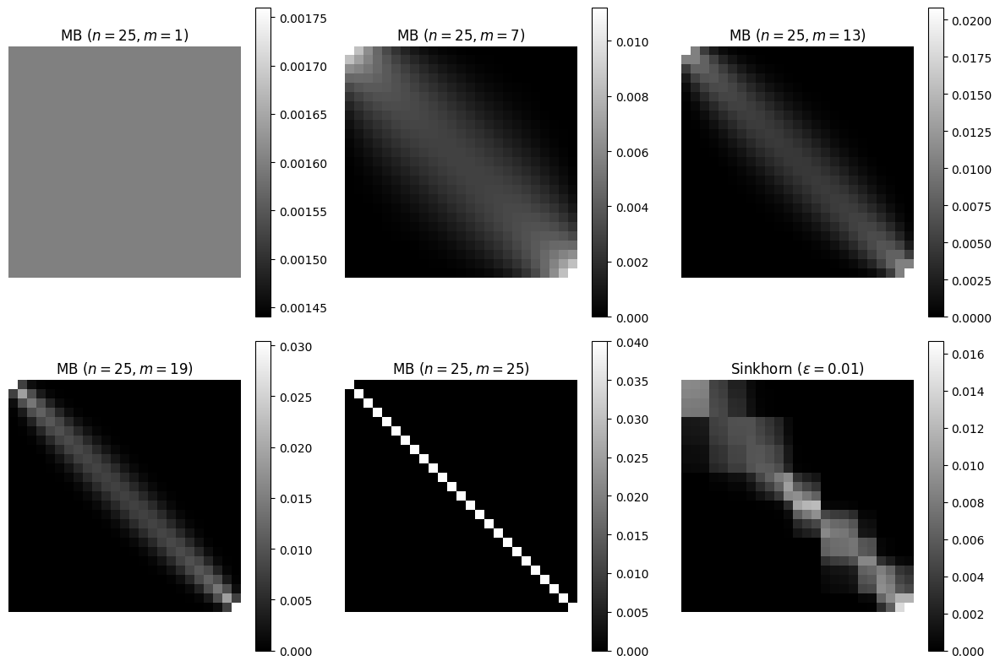

In [ ]:
n = 25
alpha, beta = uniform_dist(n, 1)
alpha.sort(axis=0)
beta.sort(axis=0)
m_list = np.linspace(1, n, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, m in enumerate(m_list):
    P = get_mbtp_1d(alpha, beta, m)  # Assurez-vous de définir get_mbtp_1d correctement
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'MB ($n={n}, m={m}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = ot.sinkhorn([], [], ot.dist(alpha, beta), reg=0.01, numItermax=5000)
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Sinkhorn ($\epsilon=0.01$)')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'mbot_matrix_{n}.png')

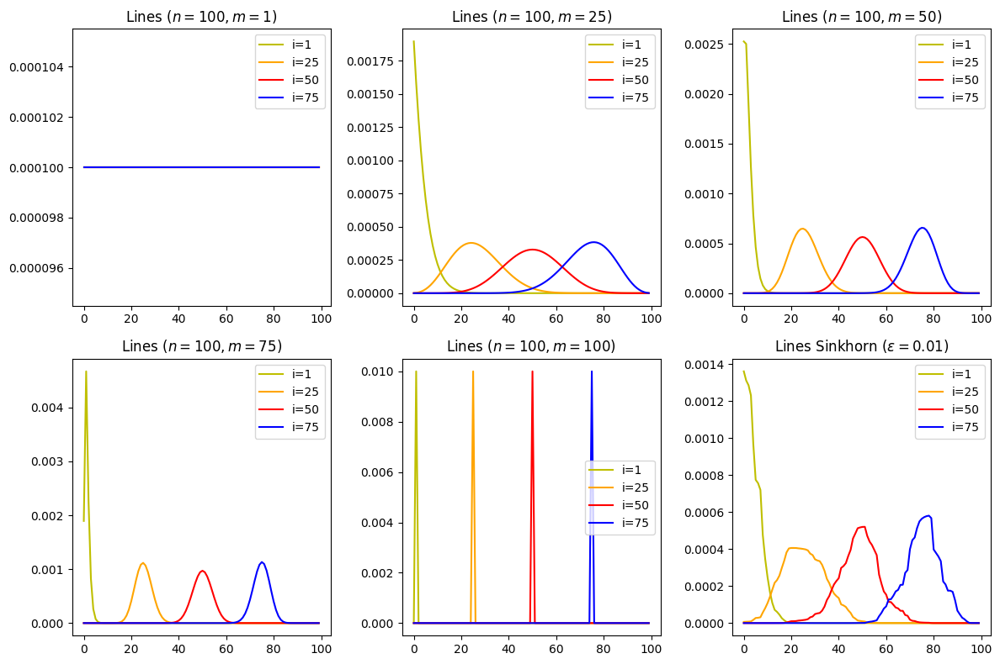

In [ ]:
n = 100
alpha, beta = uniform_dist(n, 1)
alpha.sort(axis=0)
beta.sort(axis=0)
m_list = np.linspace(1, n, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, m in enumerate(m_list):
    P = get_mbtp_1d(alpha, beta, m)  # Assurez-vous de définir get_mbtp_1d correctement
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'Lines ($n={n}, m={m}$)')
    ax.plot(P[m_list[0]], c='y', label=f'i={m_list[0]}')
    ax.plot(P[m_list[1]], c='orange', label=f'i={m_list[1]}')
    ax.plot(P[m_list[2]], c='r', label=f'i={m_list[2]}')
    ax.plot(P[m_list[3]], c='b', label=f'i={m_list[3]}')
    ax.legend()

P = ot.sinkhorn([], [], ot.dist(alpha, beta), reg=1e-2)
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Lines Sinkhorn ($\epsilon = 0.01$)')
ax.plot(P[m_list[0]], c='y', label=f'i={m_list[0]}')
ax.plot(P[m_list[1]], c='orange', label=f'i={m_list[1]}')
ax.plot(P[m_list[2]], c='r', label=f'i={m_list[2]}')
ax.plot(P[m_list[3]], c='b', label=f'i={m_list[3]}')
ax.legend()

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]

plt.tight_layout()
plt.show()

fig.savefig(f'lines_mb_{n}.png')

<ipython-input-101-cfa2403fa891>:12: RuntimeWarning: divide by zero encountered in divide
  k_max = (n / m) ** 3 * np.log(n) / np.log(m)


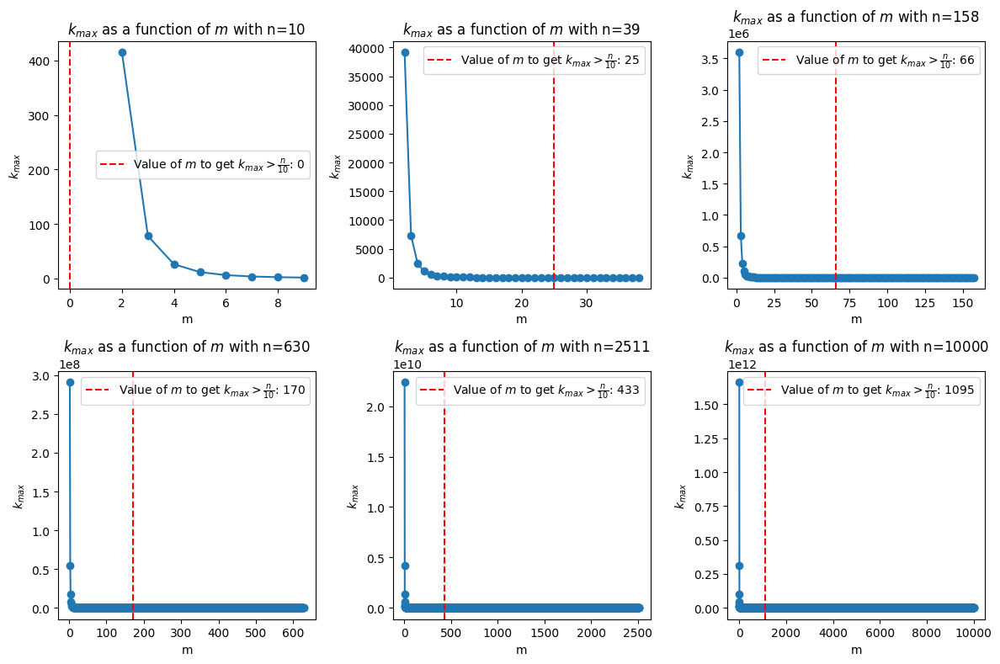

In [ ]:
n_list = np.logspace(1, 4, 6).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, n in enumerate(n_list):
    m = np.arange(1, n)
    k_max = (n / m) ** 3 * np.log(n) / np.log(m)
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.plot(m, k_max, marker='o', linestyle='-')
    ax.set_xlabel('m')
    ax.axvline(x=np.argmin(k_max > n/10), color='red', linestyle='--', label=r'Value of $m$ to get $k_{max} > \frac{n}{10}$' + f': {np.argmin(k_max > n/10)}')
    ax.set_ylabel(r'$k_{max}$')
    ax.legend()
    ax.set_title(r'$k_{max}$ as a function of $m$ with ' + f'n={n}')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]

plt.tight_layout()
plt.show()

fig.savefig(f'kmax_emd.png')

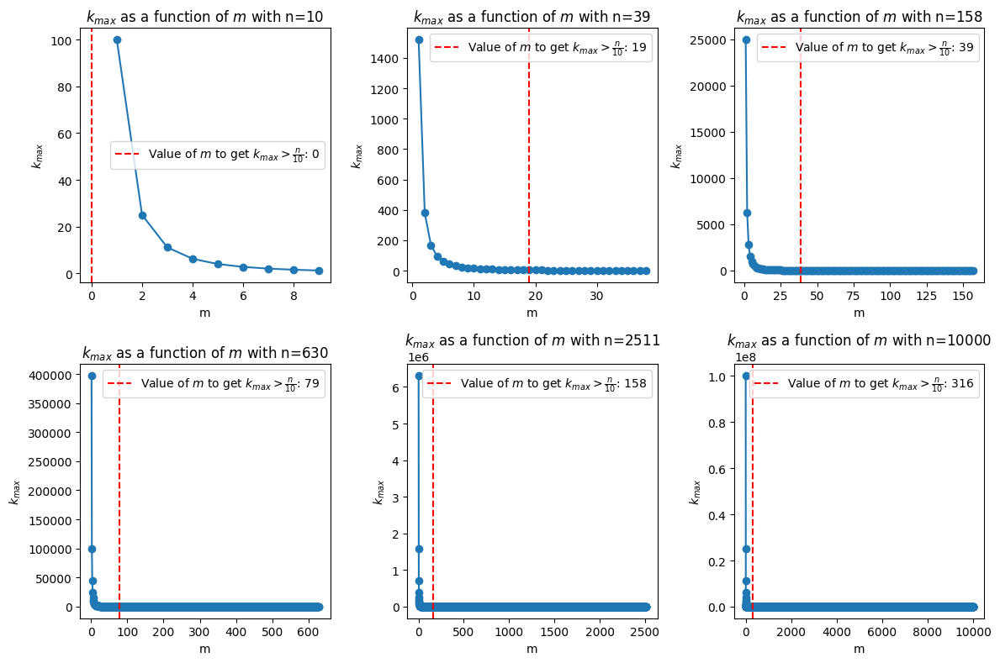

In [ ]:
n_list = np.logspace(1, 4, 6).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, n in enumerate(n_list):
    m = np.arange(1, n)
    k_max = (n / m) ** 2
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.plot(m, k_max, marker='o', linestyle='-')
    ax.set_xlabel('m')
    ax.axvline(x=np.argmin(k_max > n/10), color='red', linestyle='--', label=r'Value of $m$ to get $k_{max} > \frac{n}{10}$' + f': {np.argmin(k_max > n/10)}')
    ax.set_ylabel(r'$k_{max}$')
    ax.legend()
    ax.set_title(r'$k_{max}$ as a function of $m$ with ' + f'n={n}')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]

plt.tight_layout()
plt.show()

fig.savefig(f'kmax_sink.png')

Range of admissible $m$ for EMD.

<ipython-input-36-cdd987a6e7a2>:12: RuntimeWarning: divide by zero encountered in divide
  k_max = (n / m) ** 3 * np.log(n) / np.log(m)


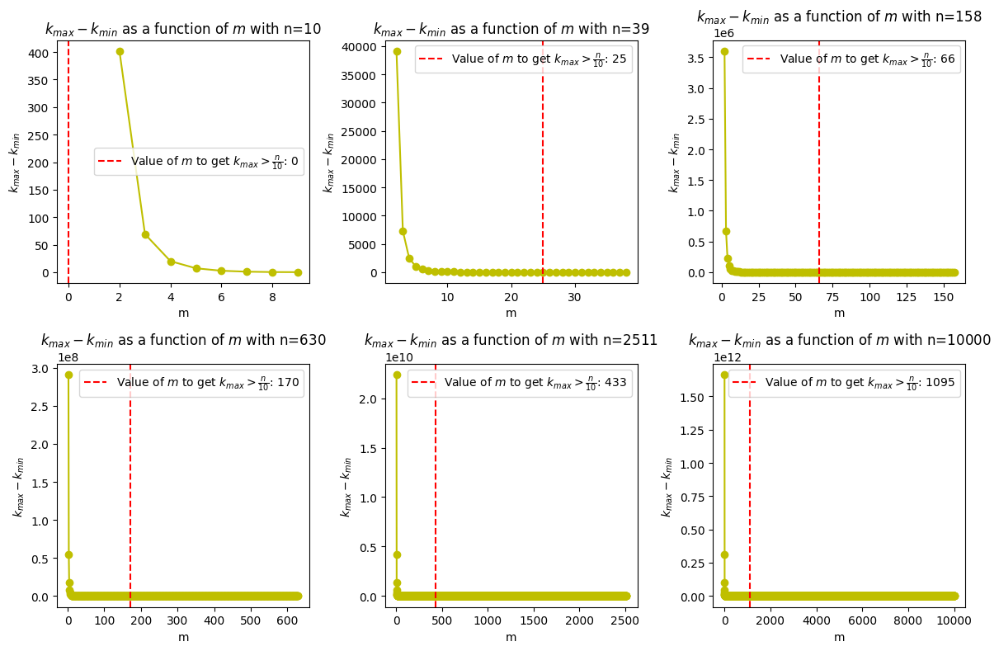

In [ ]:
n_list = np.logspace(1, 4, 6).astype(int)

# Création de la figure
num_plots = 6
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, n in enumerate(n_list):
    m = np.arange(1, n)
    k_max = (n / m) ** 3 * np.log(n) / np.log(m)
    k_min = np.log(0.05) / np.log(1-m/n)
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.plot(m, k_max-k_min, marker='o', linestyle='-', c='y')
    ax.axvline(x=np.argmin(k_max > n/10), color='red', linestyle='--', label=r'Value of $m$ to get $k_{max} > \frac{n}{10}$' + f': {np.argmin(k_max > n/10)}')
    ax.set_xlabel('m')
    ax.set_ylabel(r'$k_{max}-k_{min}$')
    ax.legend()
    ax.set_title(r'$k_{max}-k_{min}$ as a function of $m$ with ' + f'n={n}')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(6, num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]

plt.tight_layout()
plt.show()

fig.savefig(f'm_adm_emd.png')

Range of admissible $m$ for Sinkhorn.

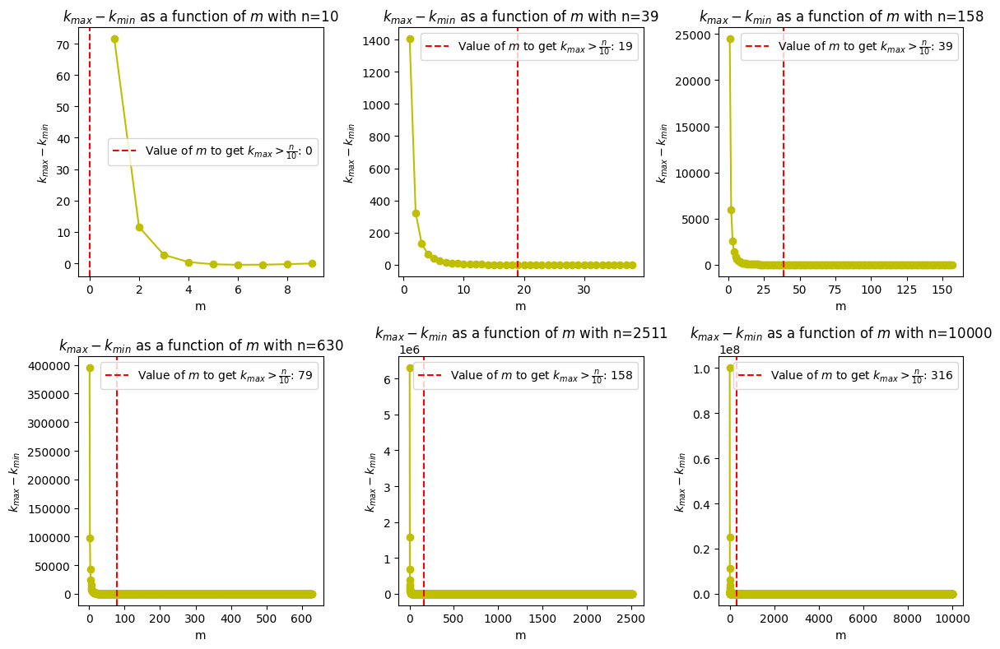

In [ ]:
n_list = np.logspace(1, 4, 6).astype(int)

# Création de la figure
num_plots = 6
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, n in enumerate(n_list):
    m = np.arange(1, n)
    k_max = (n / m) ** 2
    k_min = np.log(0.05) / np.log(1-m/n)
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.plot(m, k_max-k_min, marker='o', linestyle='-', c='y')
    ax.axvline(x=np.argmin(k_max > n/10), color='red', linestyle='--', label=r'Value of $m$ to get $k_{max} > \frac{n}{10}$' + f': {np.argmin(k_max > n/10)}')
    ax.set_xlabel('m')
    ax.set_ylabel(r'$k_{max}-k_{min}$')
    ax.legend()
    ax.set_title(r'$k_{max}-k_{min}$ as a function of $m$ with ' + f'n={n}')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(6, num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]

plt.tight_layout()
plt.show()

fig.savefig(f'm_adm_sink.png')

Evolution of P when k and m vary when we take emd.

100%|██████████| 2/2 [00:00<00:00, 696.03it/s]


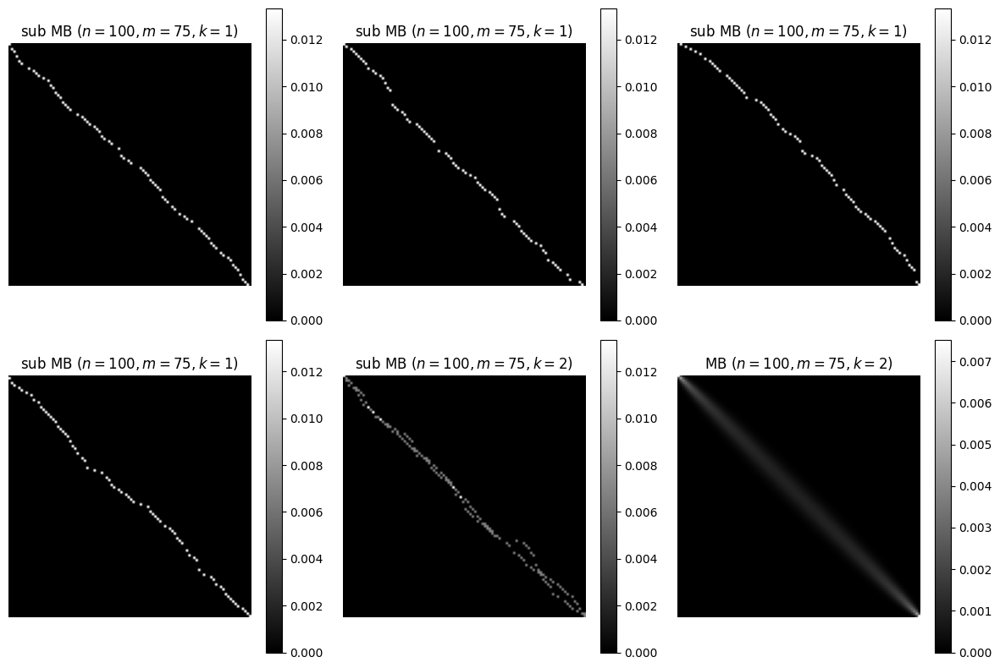

In [ ]:
n = 100
alpha, beta = uniform_dist(n, 1)
alpha.sort(axis=0)
beta.sort(axis=0)

m = 3*n//4
k_max_emd = int((n/m)**3 * np.log(n)/np.log(m))
k_list = np.linspace(1, k_max_emd, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, k in enumerate(k_list):
    P = get_subsampled_mbtp(alpha, beta, m, k, h='emd')
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'sub MB ($n={n}, m={m}, k={k}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = get_mbtp_1d(alpha, beta, m)
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'MB ($n={n}, m={m}, k={k}$)')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'sub_mb_emd_{n}_{m}.png')

Evolution of P when k and m vary when we take sinkhorn.

100%|██████████| 16/16 [00:00<00:00, 127.87it/s]


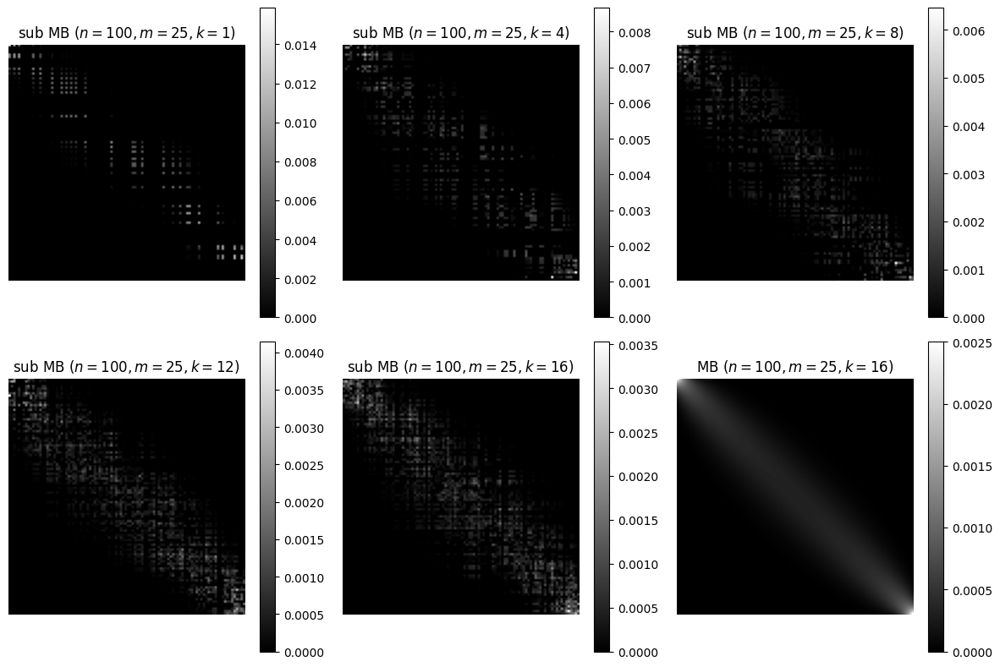

In [ ]:
n = 100
alpha, beta = uniform_dist(n, 1)
alpha.sort(axis=0)
beta.sort(axis=0)

m = n//4
k_max_emd = int((n/m)**2)
k_list = np.linspace(1, k_max_emd, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, k in enumerate(k_list):
    P = get_subsampled_mbtp(alpha, beta, m, k)
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'sub MB ($n={n}, m={m}, k={k}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = get_mbtp_1d(alpha, beta, m)
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'MB ($n={n}, m={m}, k={k}$)')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'sub_mb_sink_{n}_{m}.png')

# 2D Point Clouds

## Uniform distributions

Exact MB

m=1
m=3
m=5
m=7
m=10


TypeError: ignored

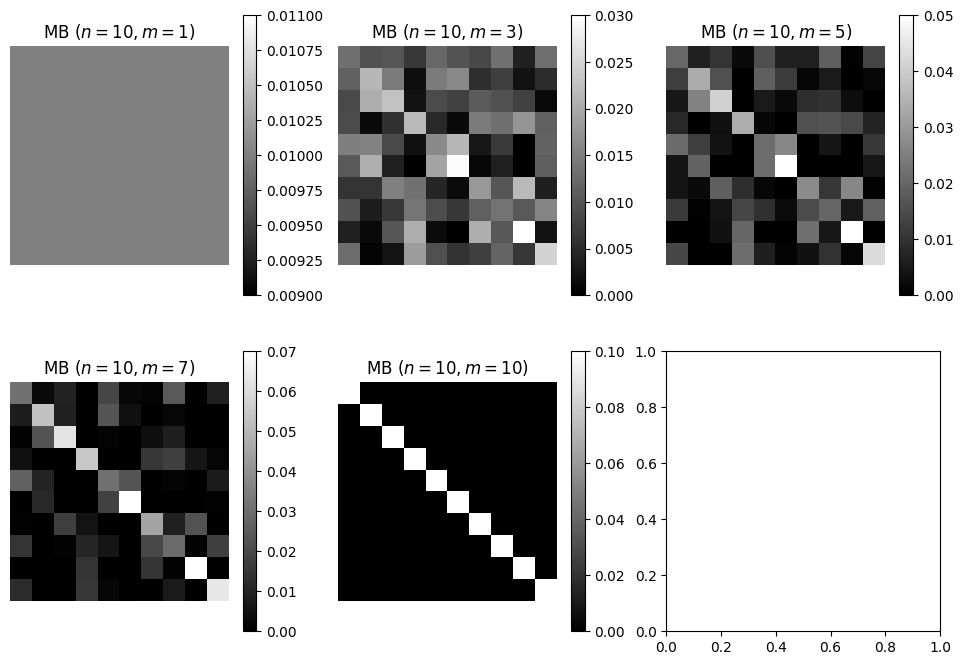

In [ ]:
n = 10
alpha, beta = uniform_dist(n, 2)
P = ot.emd([], [], ot.dist(alpha, beta))
I, J = np.nonzero(P > 1e-5)
beta = beta[J]

m_list = np.linspace(1, n, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, m in enumerate(m_list):
    print(f'm={m}')
    P = get_mbtp(alpha, beta, m, h='emd')
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'MB ($n={n}, m={m}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = ot.sinkhorn([], [], ot.dist(alpha, beta))
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Sinkhorn')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'mb_2d_{n}.png')

Variation of P when k and m vary when we take emd

100%|██████████| 2/2 [00:00<00:00, 274.38it/s]


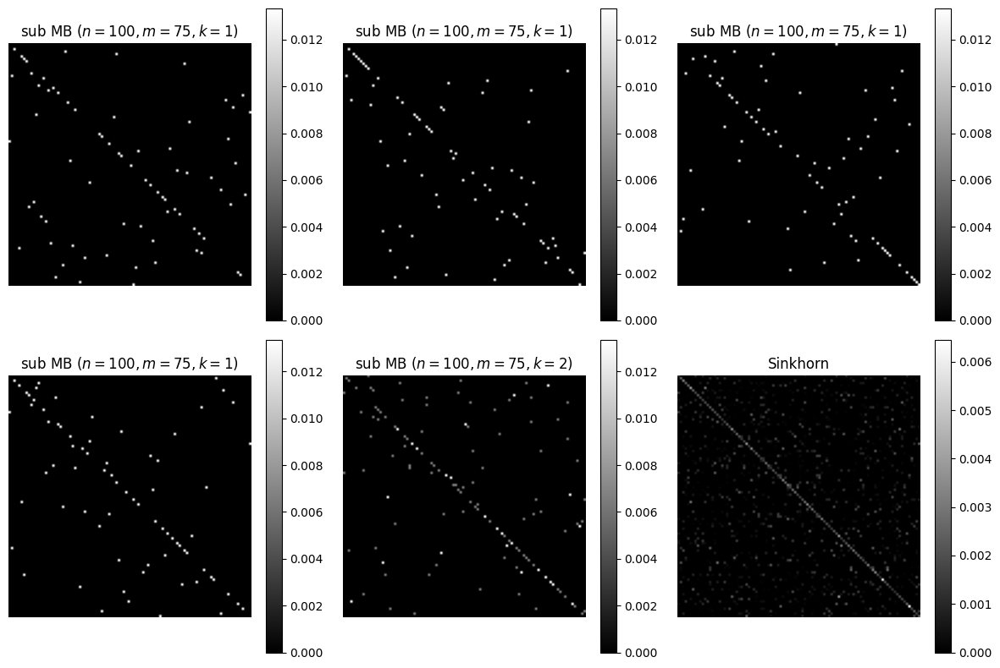

In [ ]:
n = 100
alpha, beta = uniform_dist(n, 2)
P = ot.emd([], [], ot.dist(alpha, beta))
I, J = np.nonzero(P > 1e-5)
beta = beta[J]

m = 3*n//4
k_max_emd = int((n/m)**3 * np.log(n)/np.log(m))
k_list = np.linspace(1, k_max_emd, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, k in enumerate(k_list):
    P = get_subsampled_mbtp(alpha, beta, m, k, h='emd')
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'sub MB ($n={n}, m={m}, k={k}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = sinkhorn(unif(n), unif(n), dist(alpha, beta))
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Sinkhorn')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'sub_mb_2d_emd_{n}_{m}.png')

Variation of P when k and m vary when we take sinkhorn.

100%|██████████| 17/17 [00:01<00:00, 16.27it/s]


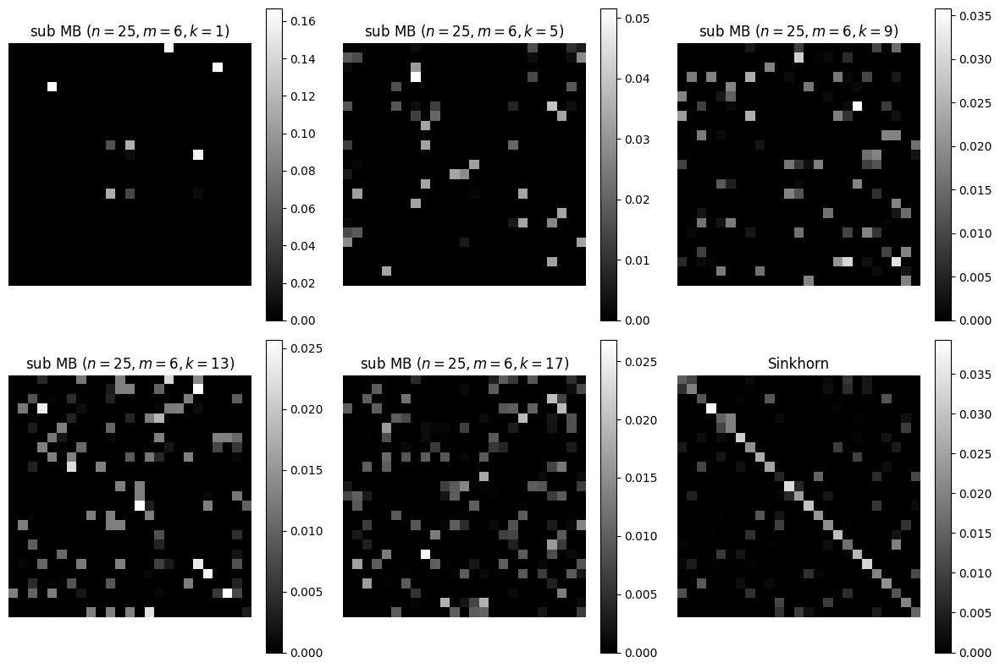

In [ ]:
n = 25
alpha, beta = uniform_dist(n, 2)
P = ot.emd([], [], ot.dist(alpha, beta))
I, J = np.nonzero(P > 1e-5)
beta = beta[J]

m = n//4
k_max_sink = int((n/m)**2)
k_list = np.linspace(1, k_max_sink, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, k in enumerate(k_list):
    P = get_subsampled_mbtp(alpha, beta, m, k)
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'sub MB ($n={n}, m={m}, k={k}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = sinkhorn(unif(n), unif(n), dist(alpha, beta))
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Sinkhorn')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'sub_mb_2d_sink_{n}_{m}.png')

## Moon set

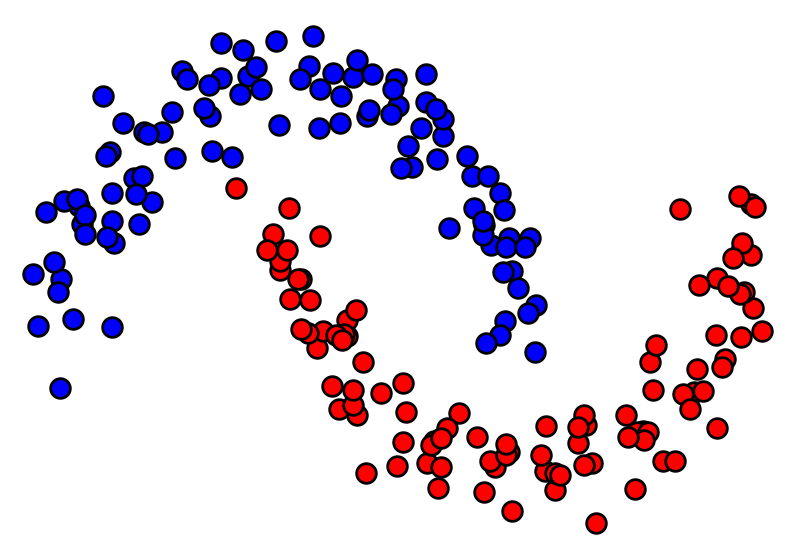

In [ ]:
n = 100

x, y = make_moons(n_samples=2*n, noise=0.1, random_state=0)

x1 = x[y == 0][:n, 0]
y1 = x[y == 0][:n, 1]
x2 = x[y == 1][:n, 0]
y2 = x[y == 1][:n, 1]

alpha =  np.vstack((x1, y1))
alpha = alpha.T
beta = np.vstack((x2, y2))
beta = beta.T

plot_datapoints_2d(alpha, beta)

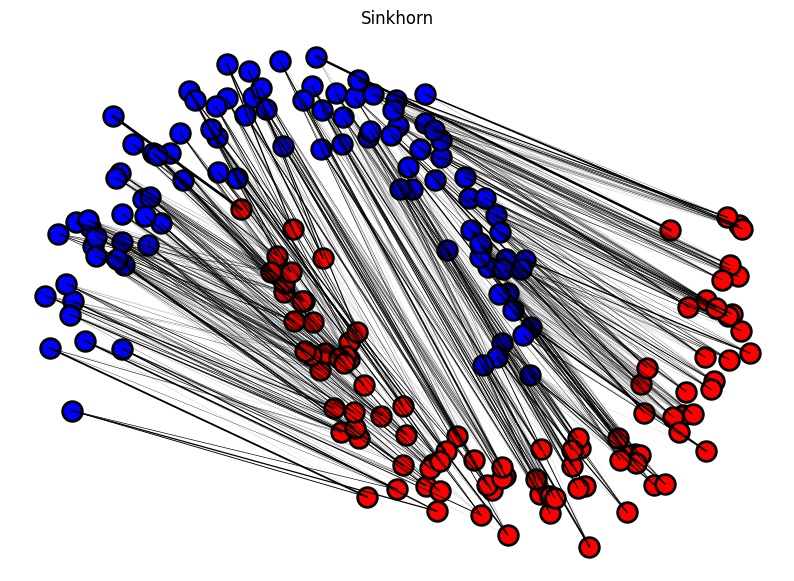

In [ ]:
P = ot.sinkhorn([], [], ot.dist(alpha, beta), reg=1e-2)
plot_transport_plan_2d(P, alpha, beta, path=f'moon_{n}_sink.png', title=f'Sinkhorn')

100%|██████████| 1/1 [00:00<00:00,  3.68it/s]


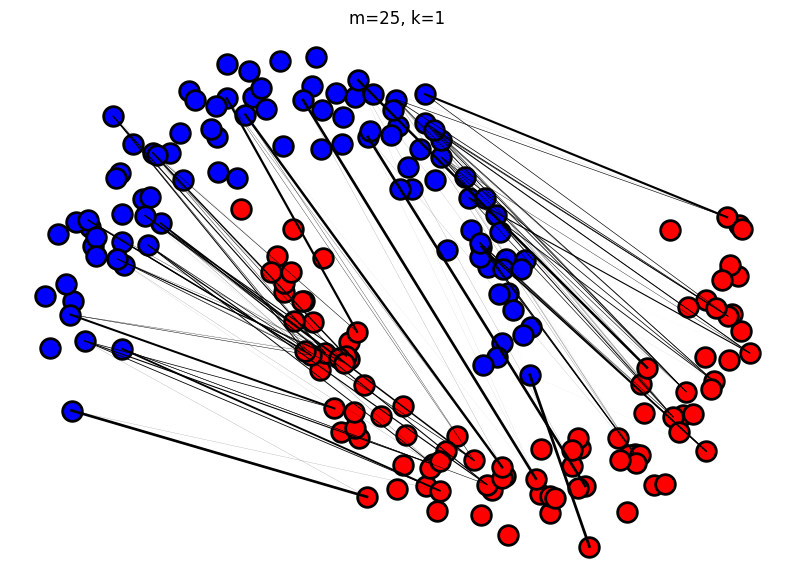

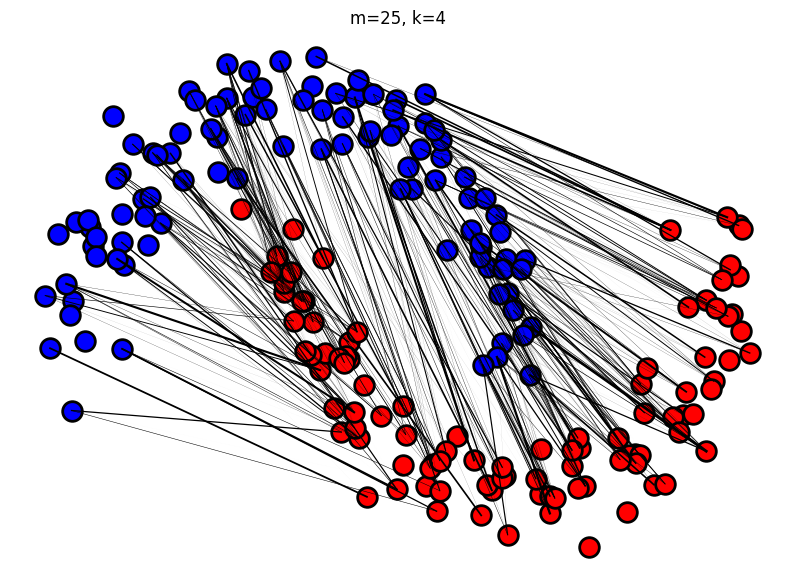

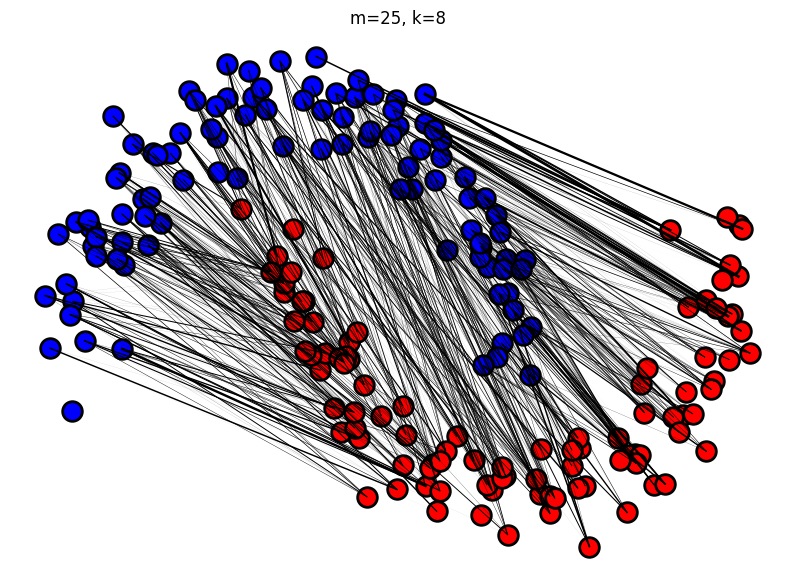

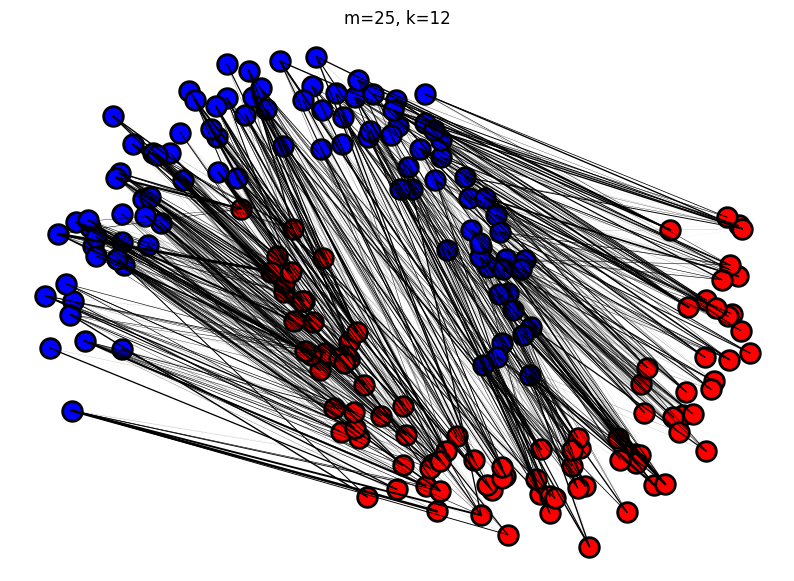

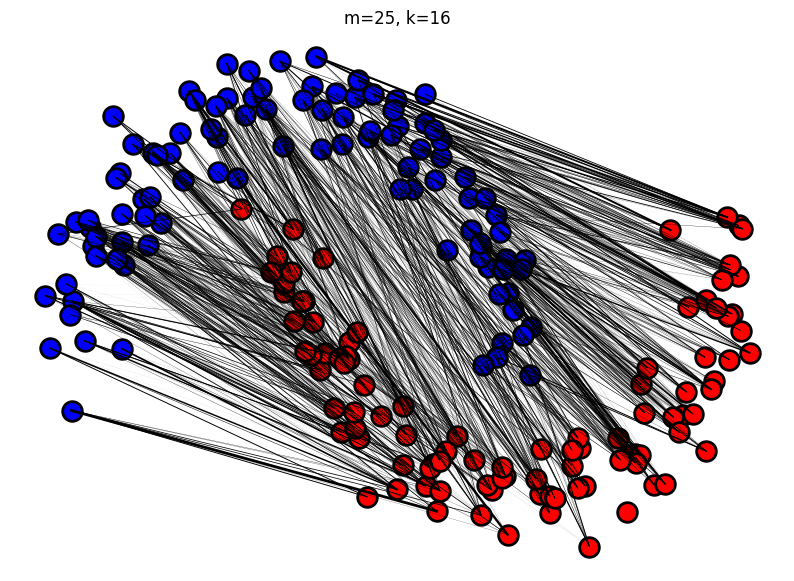

...

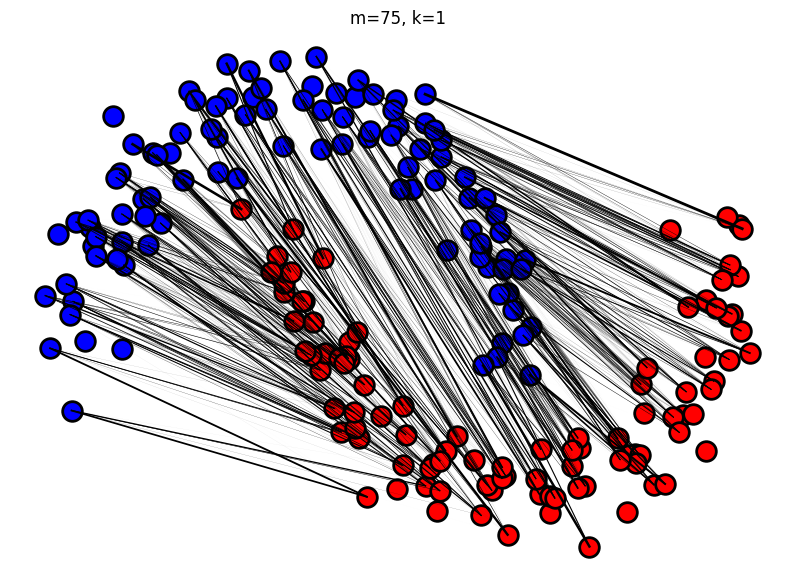

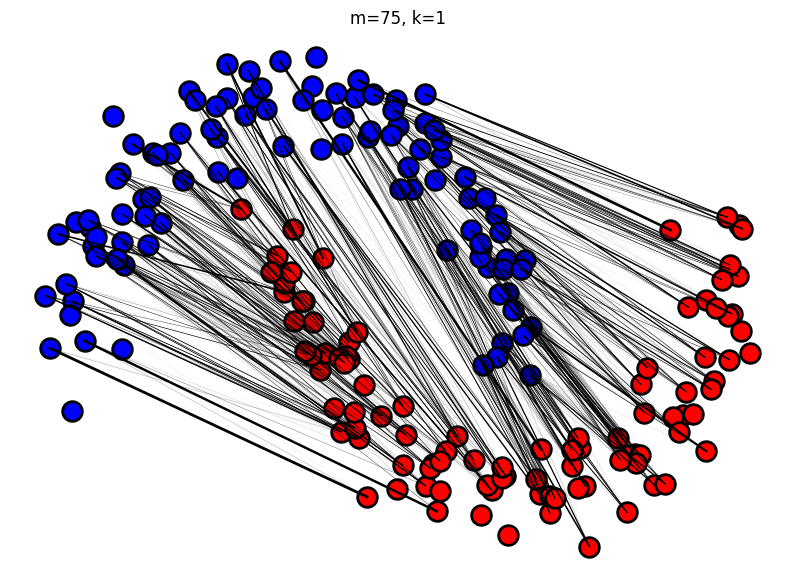

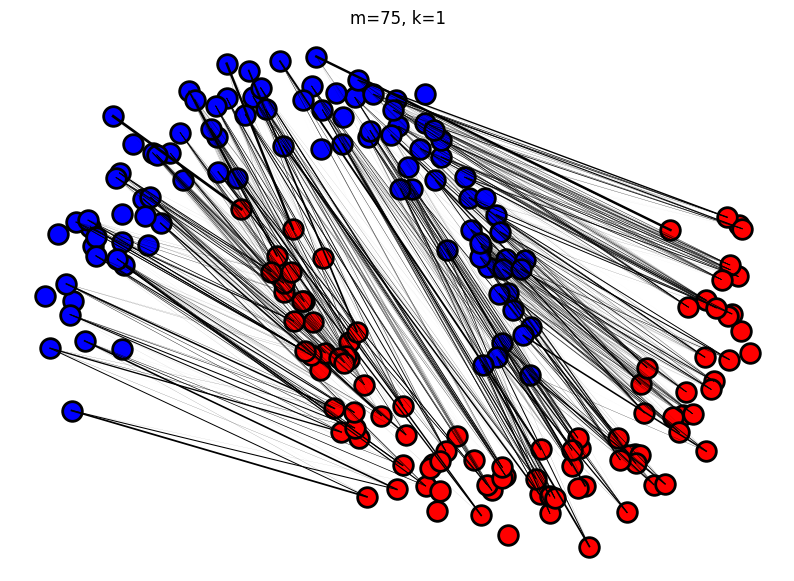

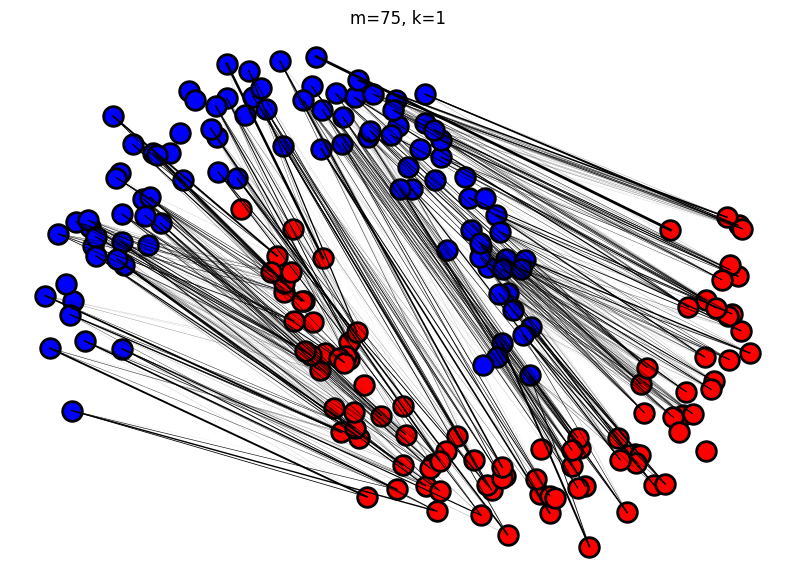

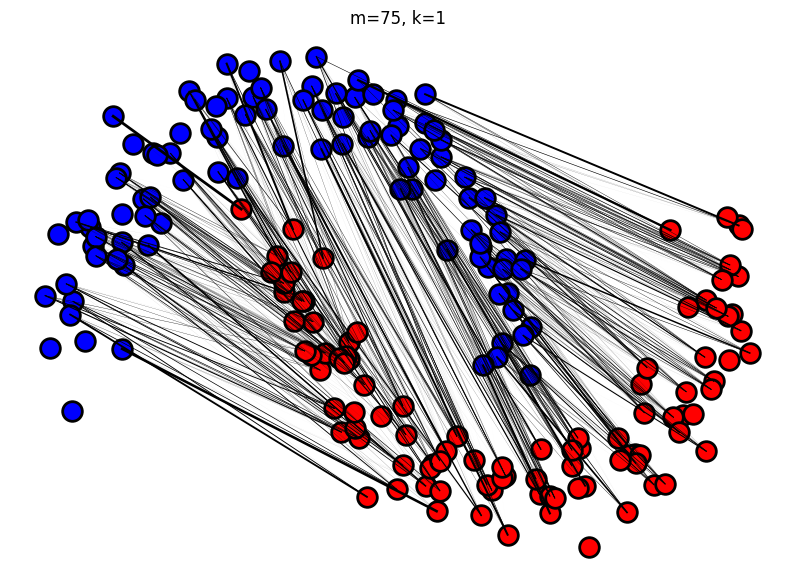

In [ ]:
m = 3*n//4
k_max = int((n/m)**2)
k_list = np.linspace(1, k_max, 5).astype(int)
m_list = [n//4, n//2, 3*n//4]

for m in m_list:
  k_max = int((n/m)**2)
  k_list = np.linspace(1, k_max, 5).astype(int)
  for k in k_list:
    P = get_subsampled_mbtp(alpha, beta, m, k, h='sinkhorn')
    plot_transport_plan_2d(P, alpha, beta, path=f'moon_{n}_sub_{m}_{k}.png', title=f'm={m}, k={k}')

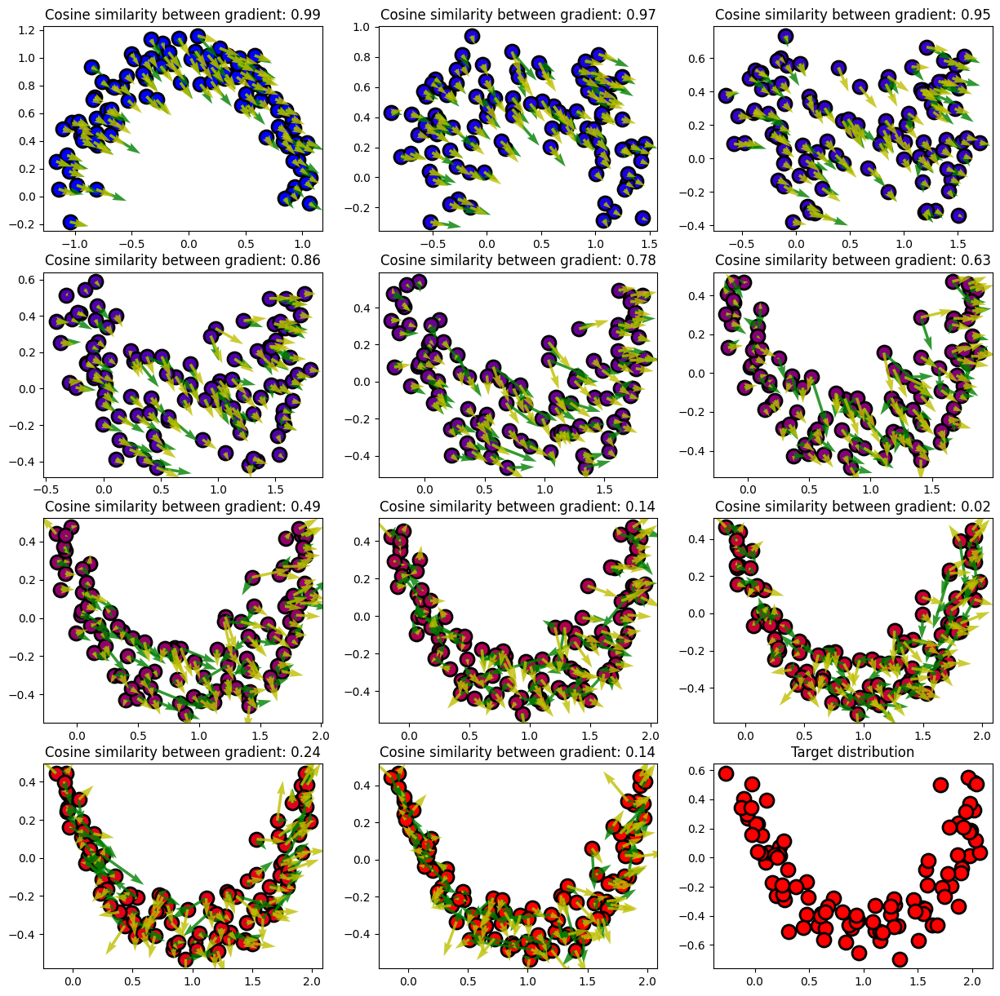

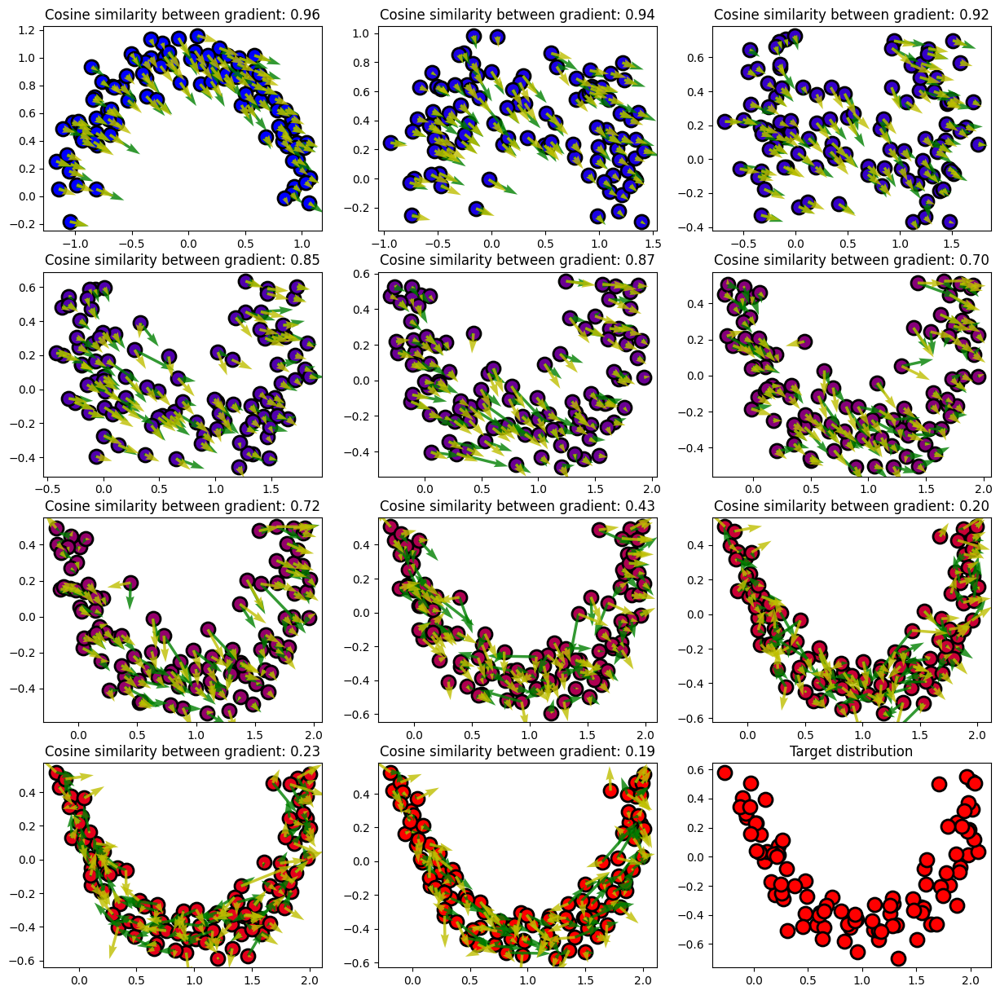

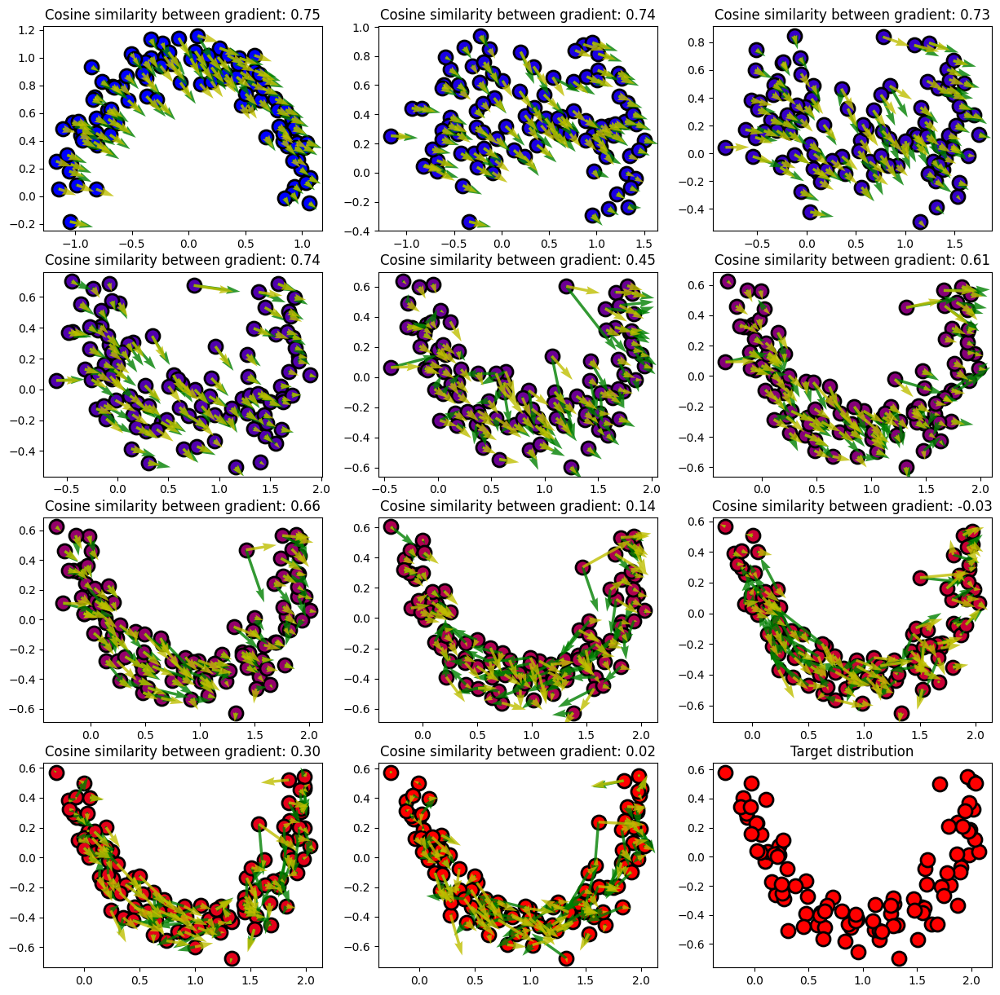

In [ ]:
m_list = [n//4, n//2, 3*n//4]
for m in m_list:
  k = int((n/m)**2)
  mb_gradient_flows_2d(alpha, beta, m, k, path=f'grad_flows_moon_{m}_{k}')

  0%|          | 0/16 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ot/bregman/_sinkhorn.py:531: UserWarning: Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.
  warnings.warn("Sinkhorn did not converge. You might want to "
100%|██████████| 16/16 [00:01<00:00, 11.09it/s]


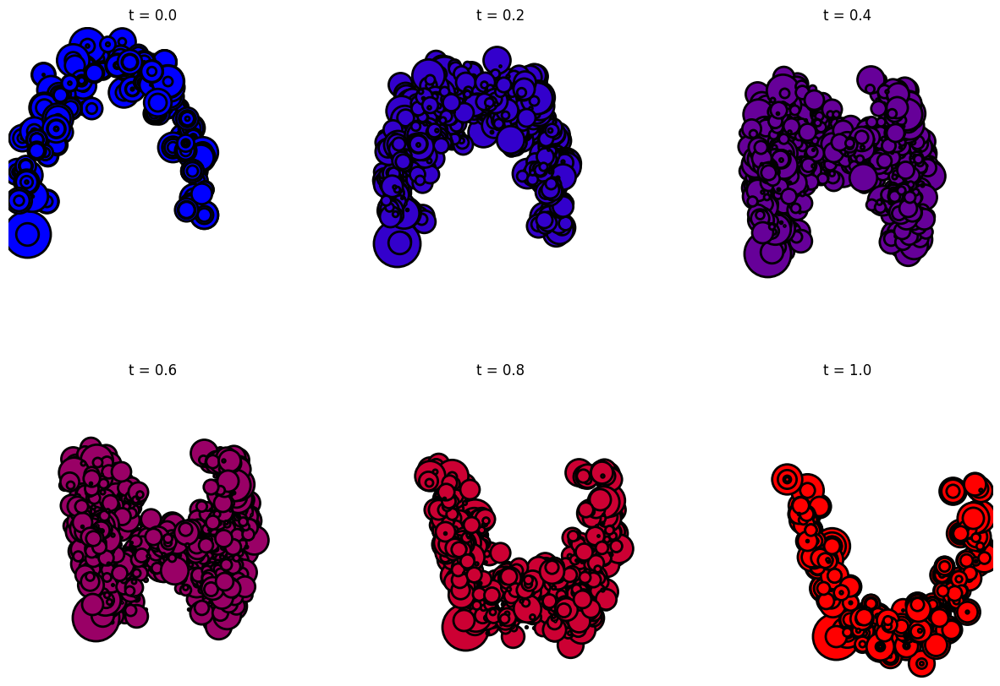

100%|██████████| 4/4 [00:00<00:00, 14.41it/s]


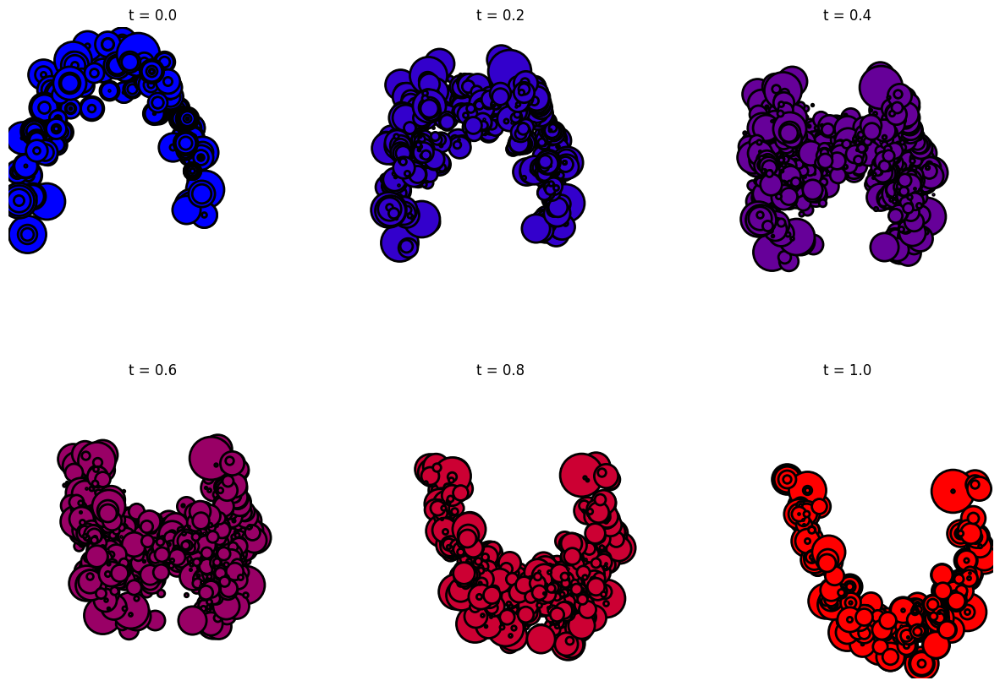

100%|██████████| 1/1 [00:00<00:00, 11.42it/s]


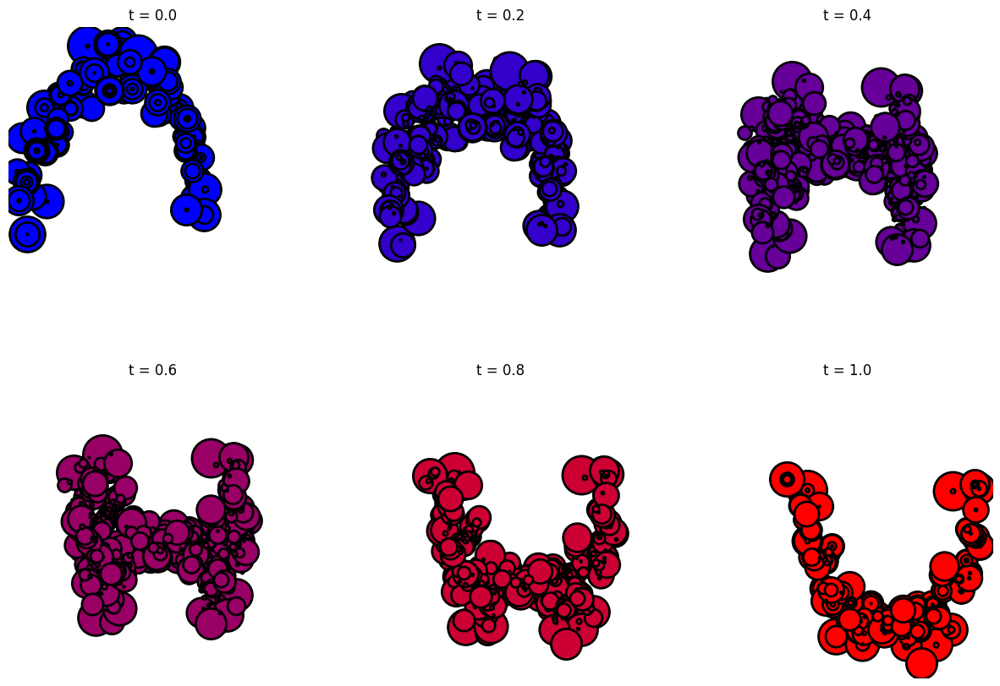

In [ ]:
m_list = [n//4, n//2, 3*n//4]
for m in m_list:
  k = int((n/m)**2)
  P = get_subsampled_mbtp(alpha, beta, m, k)
  displacement_interpolation_2d(P, alpha, beta, path=f'inter_moon_{n}_{m}_{k}.png')

# 3D Point Clouds

## Uniform distributions

Variation of P when k, m vary with emd.

100%|██████████| 129/129 [00:00<00:00, 1767.81it/s]


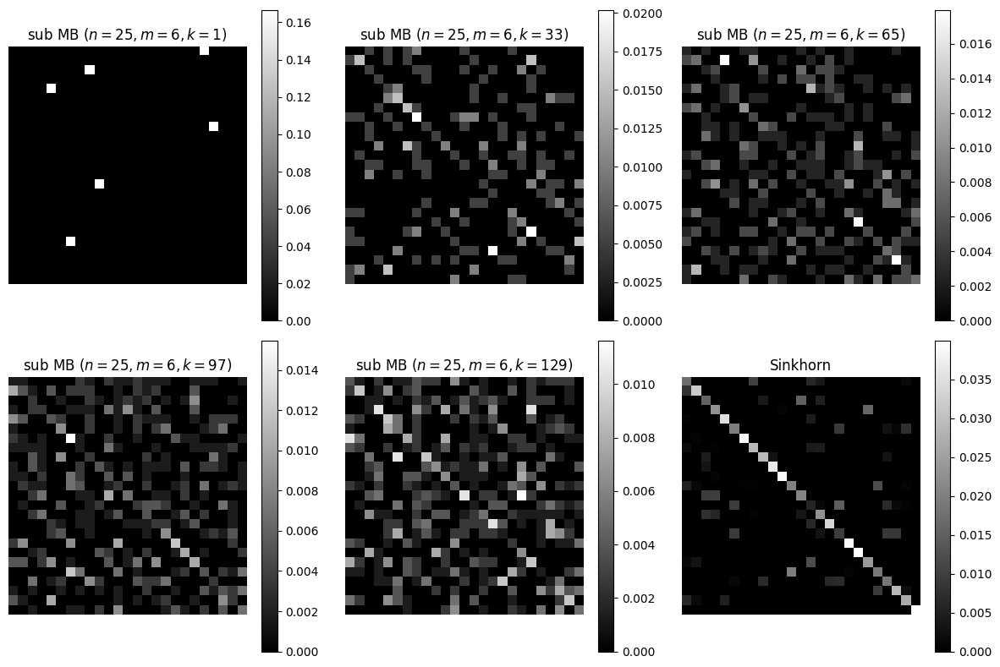

In [ ]:
n = 25
alpha, beta = uniform_dist(n, 3)
P = ot.emd([], [], ot.dist(alpha, beta))
I, J = np.nonzero(P > 1e-5)
beta = beta[J]

m = n//4
k_max_emd = int((n/m)**3 * np.log(n)/np.log(m))
k_list = np.linspace(1, k_max_emd, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, k in enumerate(k_list):
    P = get_subsampled_mbtp(alpha, beta, m, k, h='emd')
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'sub MB ($n={n}, m={m}, k={k}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = sinkhorn(unif(n), unif(n), dist(alpha, beta))
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Sinkhorn')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'sub_mb_3d_emd_{n}_{m}.png')

Variation of P when k, m vary with sinkhorn.

100%|██████████| 1/1 [00:00<00:00,  1.22it/s]


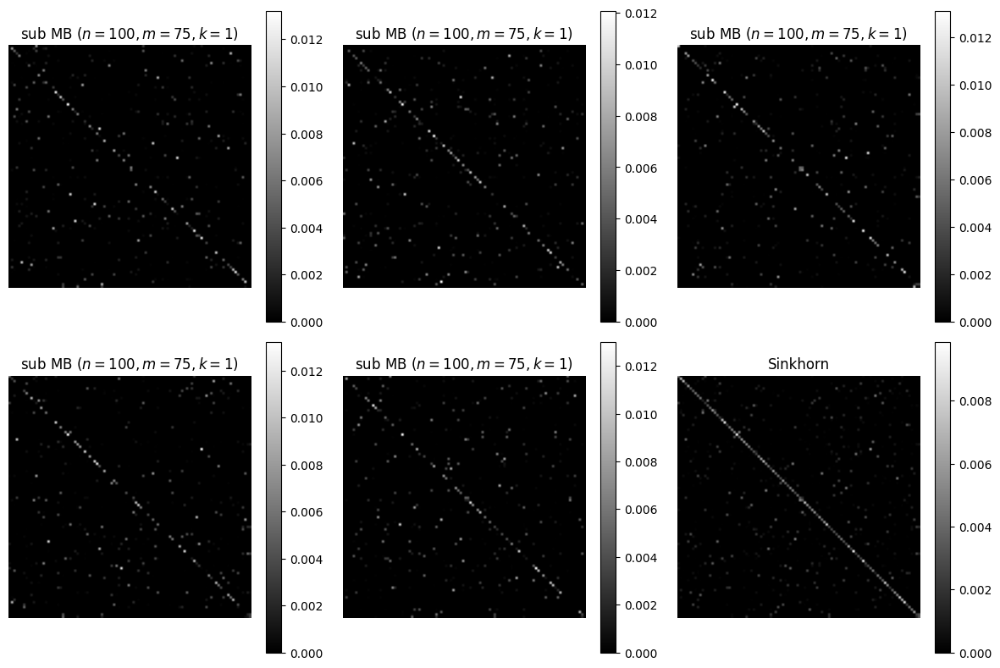

In [ ]:
n = 100
alpha, beta = uniform_dist(n, 3)
P = ot.emd([], [], ot.dist(alpha, beta))
I, J = np.nonzero(P > 1e-5)
beta = beta[J]

m = 3*n//4
k_max_emd = int((n/m)**2)
k_list = np.linspace(1, k_max_emd, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, k in enumerate(k_list):
    P = get_subsampled_mbtp(alpha, beta, m, k)
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'sub MB ($n={n}, m={m}, k={k}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = sinkhorn(unif(n), unif(n), dist(alpha, beta))
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Sinkhorn')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'sub_mb_3d_sink_{n}_{m}.png')

## Set 1

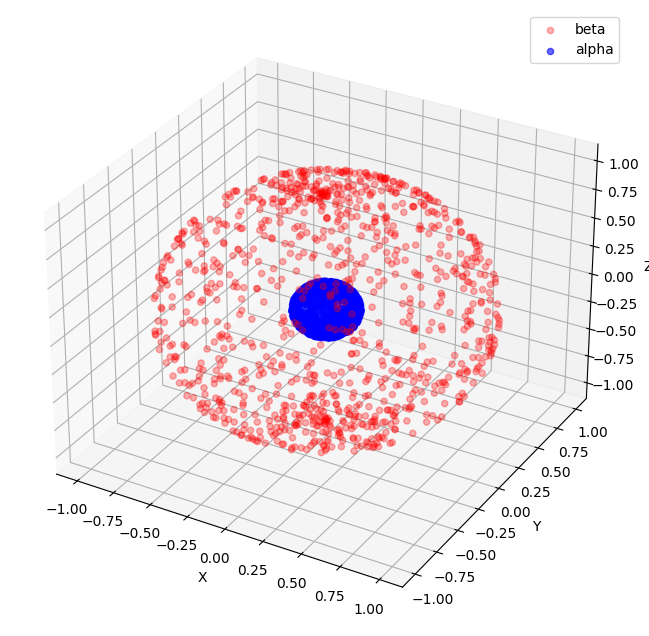

In [ ]:
# Fonction pour générer des points pour une sphère
n = num_points_sphere = num_points_ball = 1000

# Génération de la sphère intérieure
ball_radius = 0.2
ball_center = np.array([0, 0, 0])
alpha = generate_sphere(ball_radius, ball_center, num_points_ball)

# Génération de la sphère extérieure
sphere_radius = 1.0
sphere_center = np.array([0, 0, 0])
beta = generate_sphere(sphere_radius, sphere_center, num_points_sphere)

plot_datapoints_3d(alpha, beta)

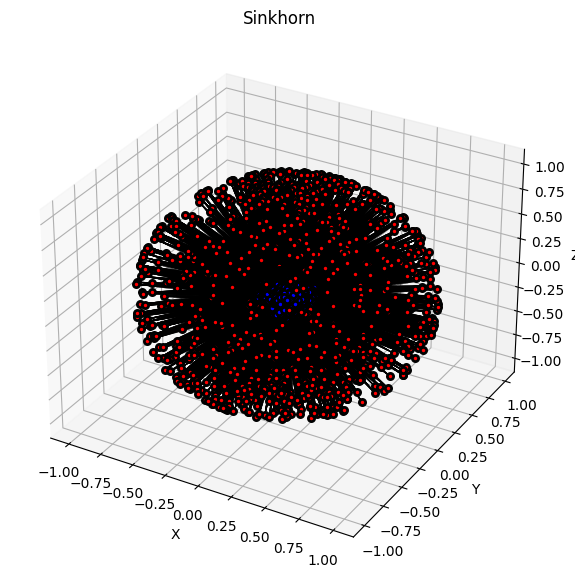

In [ ]:
P = ot.sinkhorn([], [], ot.dist(alpha, beta), reg=1e-2)
plot_transport_plan_3d(P, alpha, beta, path=f'ball_{n}_sink.png', title=f'Sinkhorn')

100%|██████████| 1/1 [00:00<00:00,  9.15it/s]


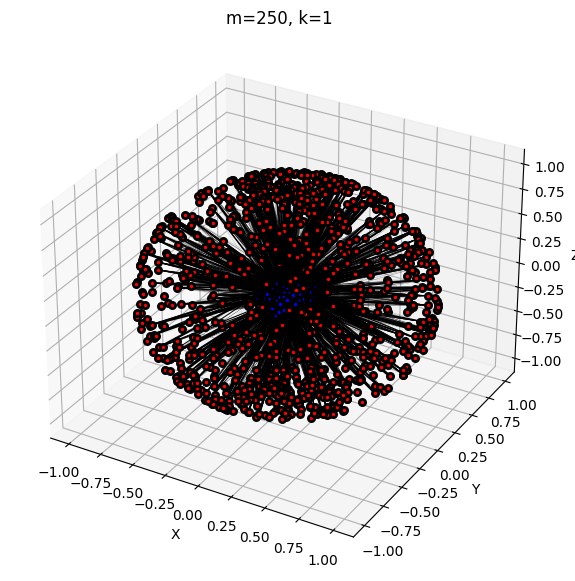

100%|██████████| 4/4 [00:00<00:00,  7.16it/s]


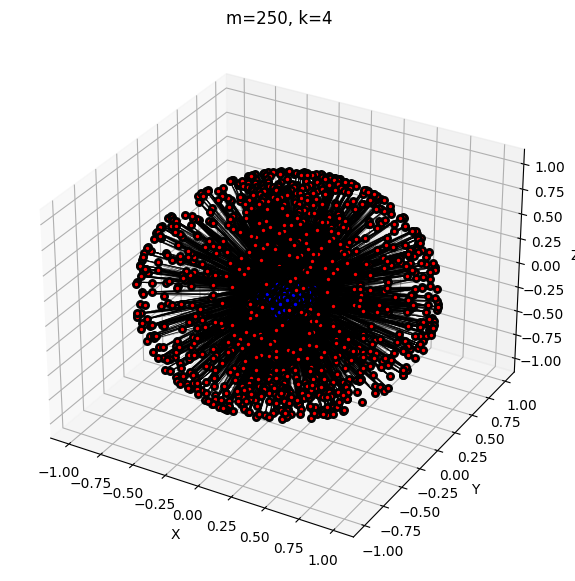

100%|██████████| 8/8 [00:00<00:00, 10.20it/s]


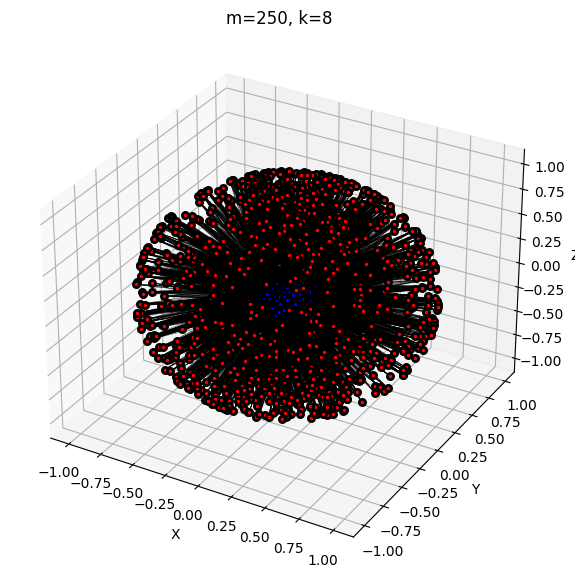

100%|██████████| 12/12 [00:01<00:00,  9.49it/s]


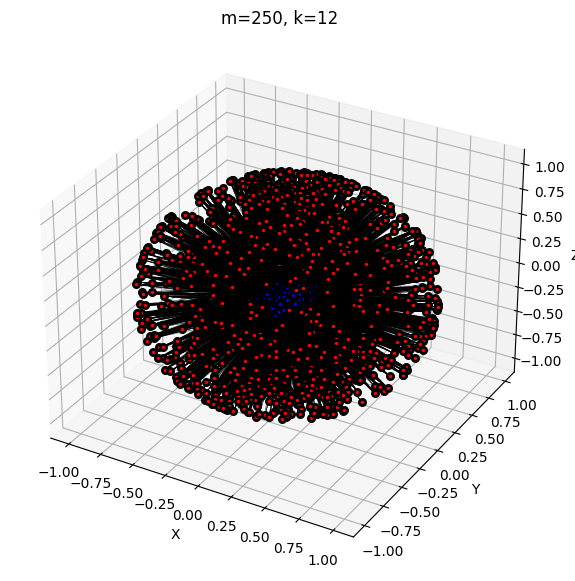

100%|██████████| 16/16 [00:01<00:00, 10.12it/s]


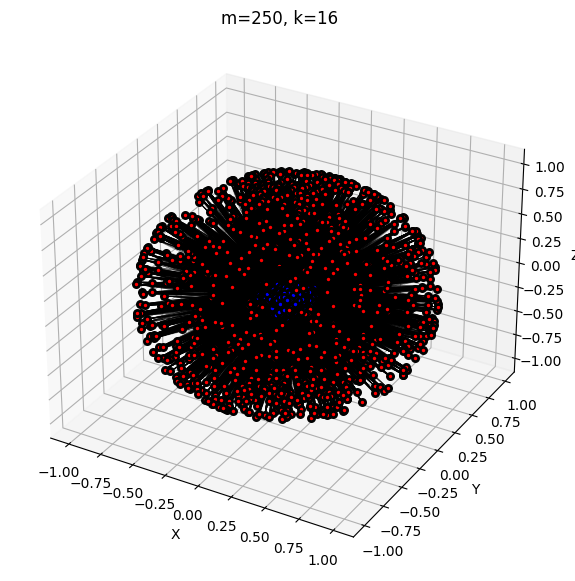

100%|██████████| 1/1 [00:00<00:00,  2.84it/s]


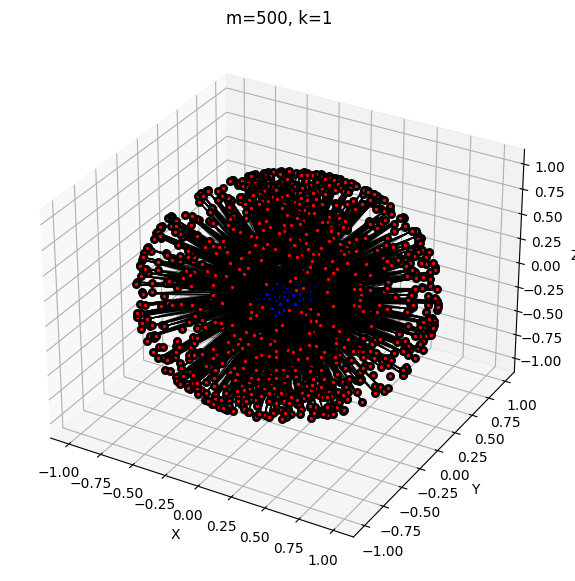

100%|██████████| 1/1 [00:00<00:00,  3.96it/s]


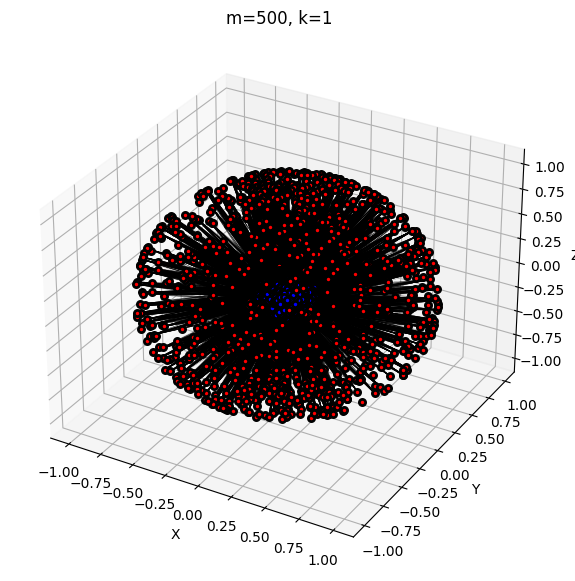

100%|██████████| 2/2 [00:01<00:00,  1.97it/s]


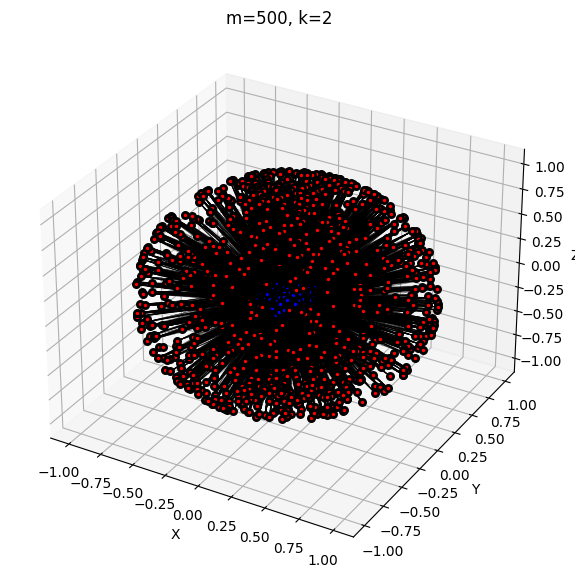

100%|██████████| 3/3 [00:00<00:00,  3.99it/s]


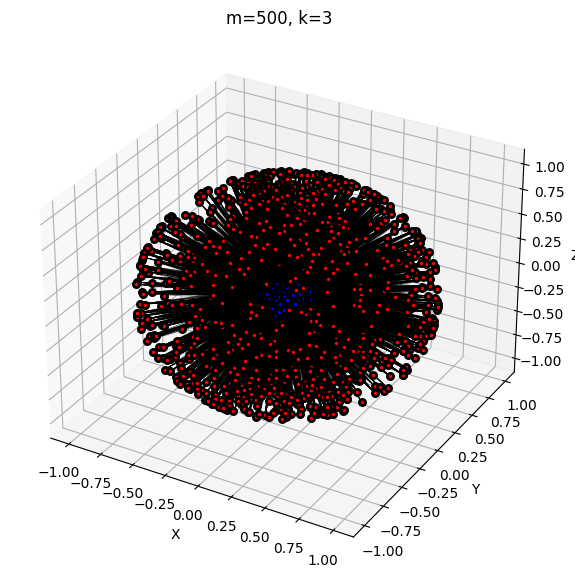

100%|██████████| 4/4 [00:00<00:00,  4.10it/s]


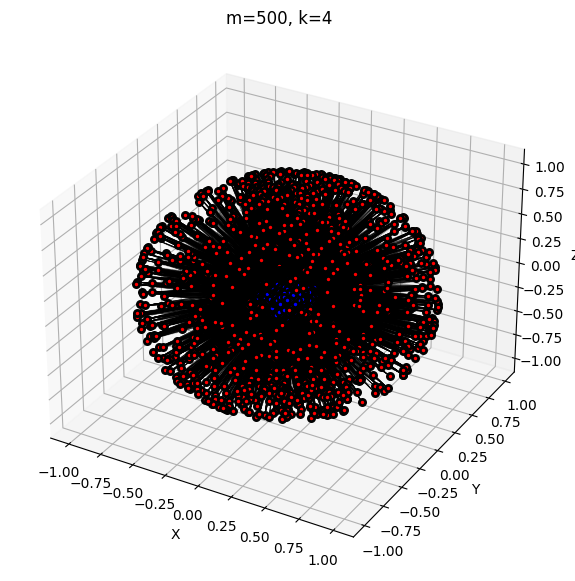

100%|██████████| 1/1 [00:00<00:00,  2.08it/s]


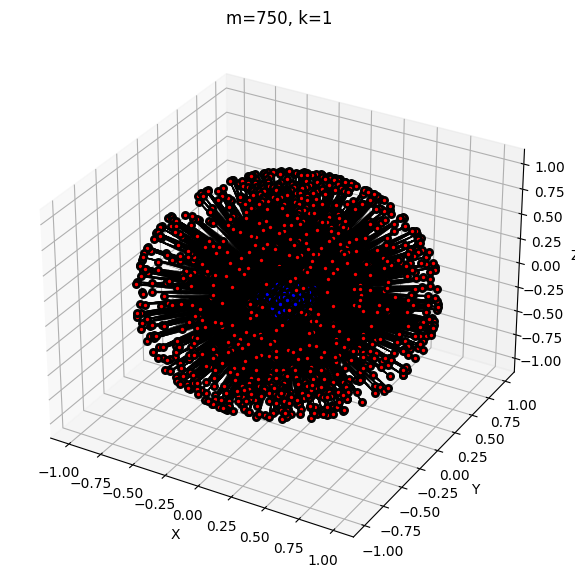

100%|██████████| 1/1 [00:00<00:00,  2.09it/s]


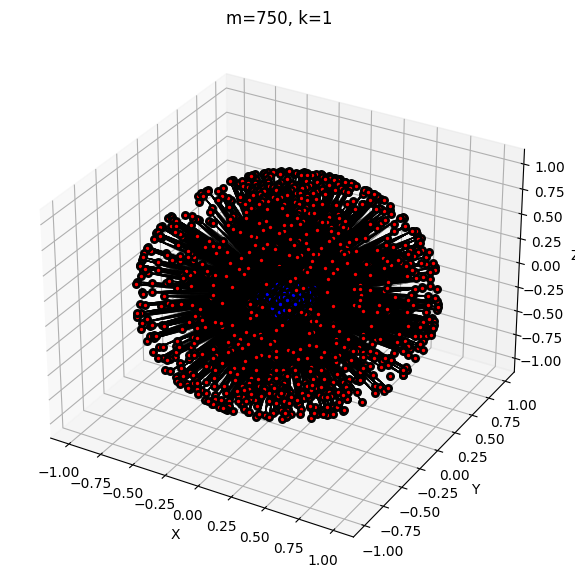

100%|██████████| 1/1 [00:00<00:00,  2.36it/s]


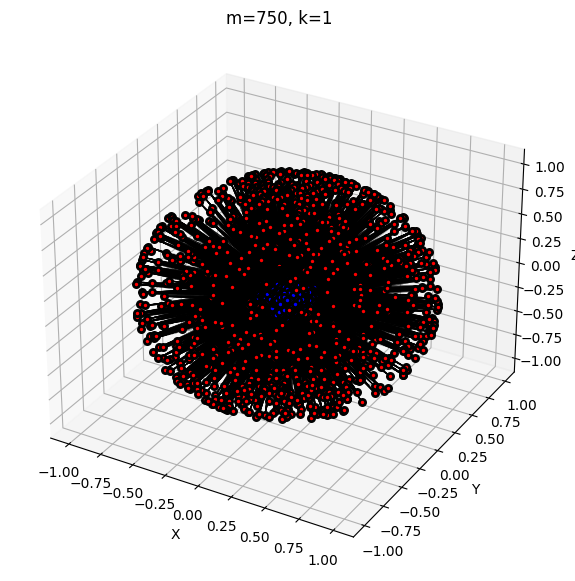

100%|██████████| 1/1 [00:00<00:00,  2.44it/s]


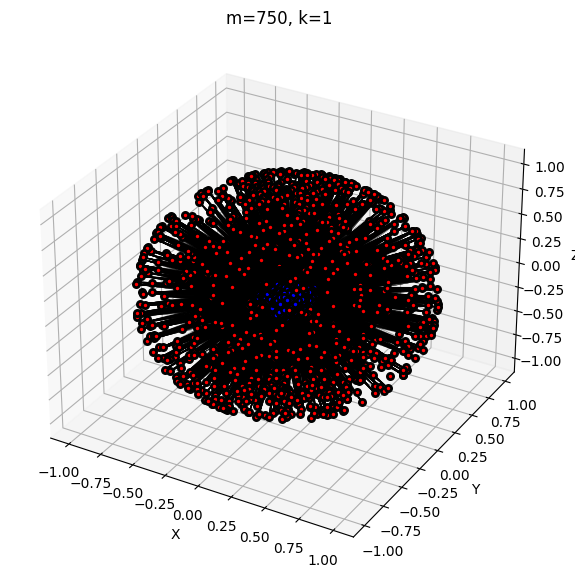

100%|██████████| 1/1 [00:00<00:00,  2.57it/s]


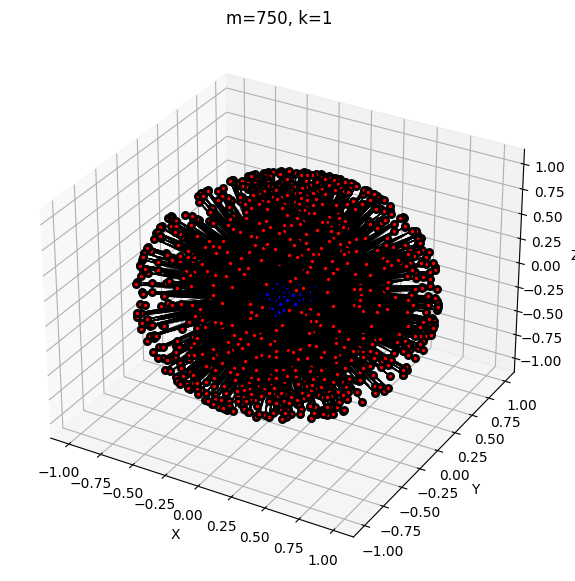

In [ ]:
m_list = [n//4, n//2, 3*n//4]

for m in m_list:
  k_max = int((n/m)**2)
  k_list = np.linspace(1, k_max, 5).astype(int)
  for k in k_list:
    P = get_subsampled_mbtp(alpha, beta, m, k)
    plot_transport_plan_3d(P, alpha, beta, path=f'ball_{n}_sub_{m}_{k}.png', title=f'm={m}, k={k}')

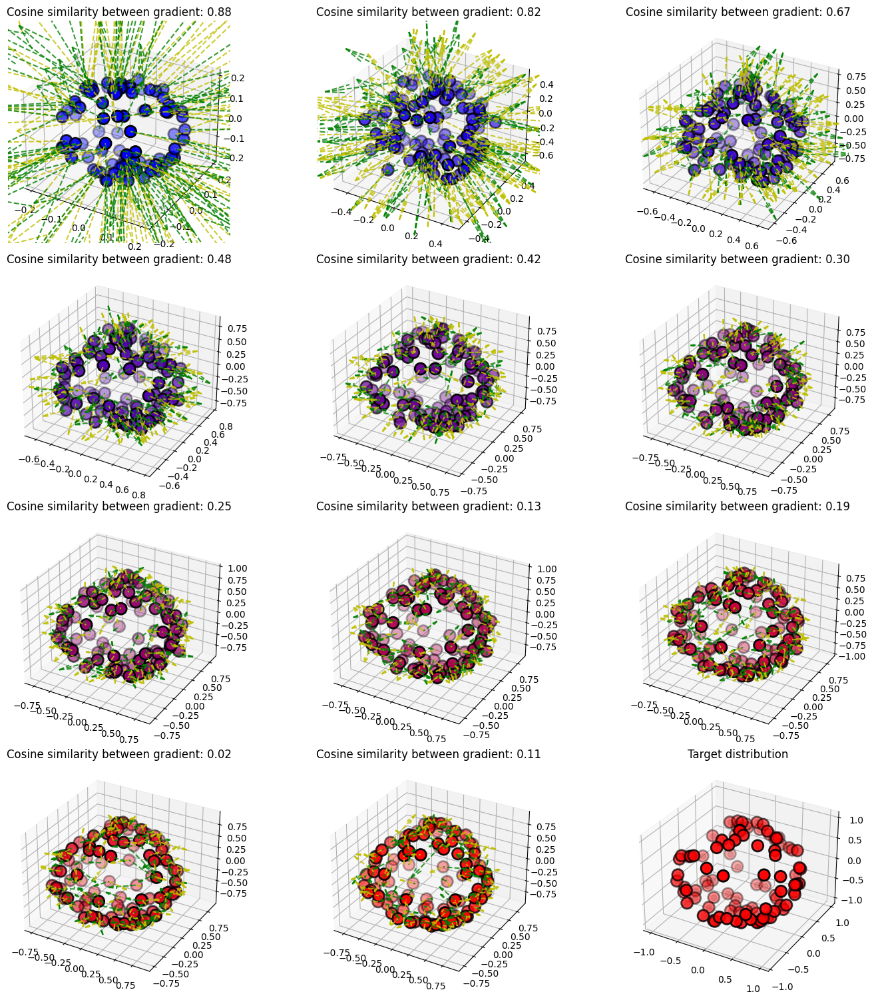

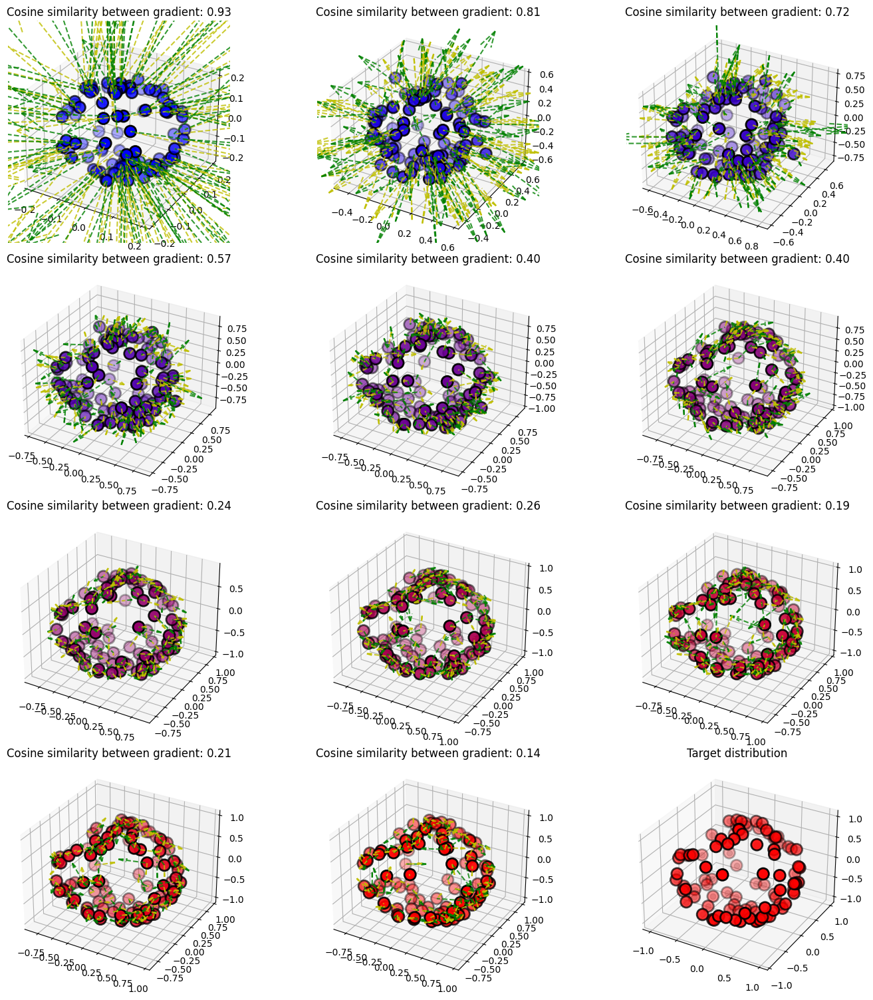

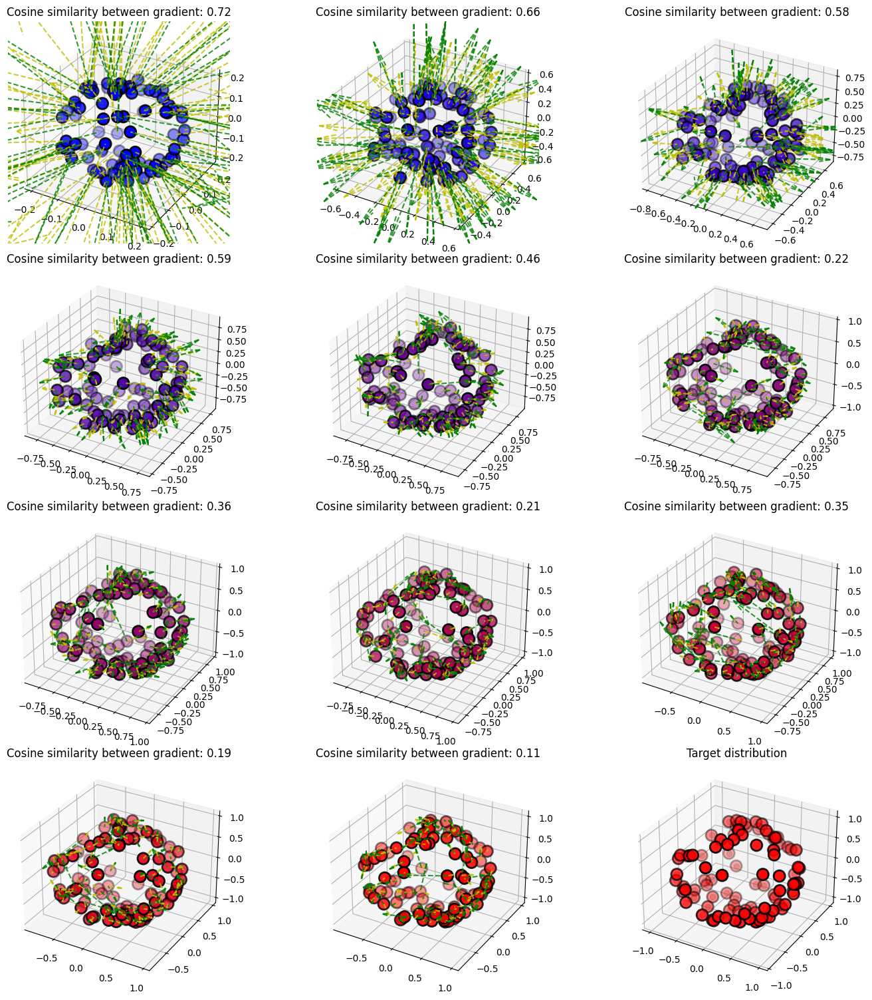

In [ ]:
m_list = [n//4, n//2, 3*n//4]
for m in m_list:
  k = int((n/m)**2)
  mb_gradient_flows_3d(alpha, beta, m, k, path=f'grad_flows_ball_{m}_{k}')

100%|██████████| 16/16 [00:01<00:00, 10.48it/s]


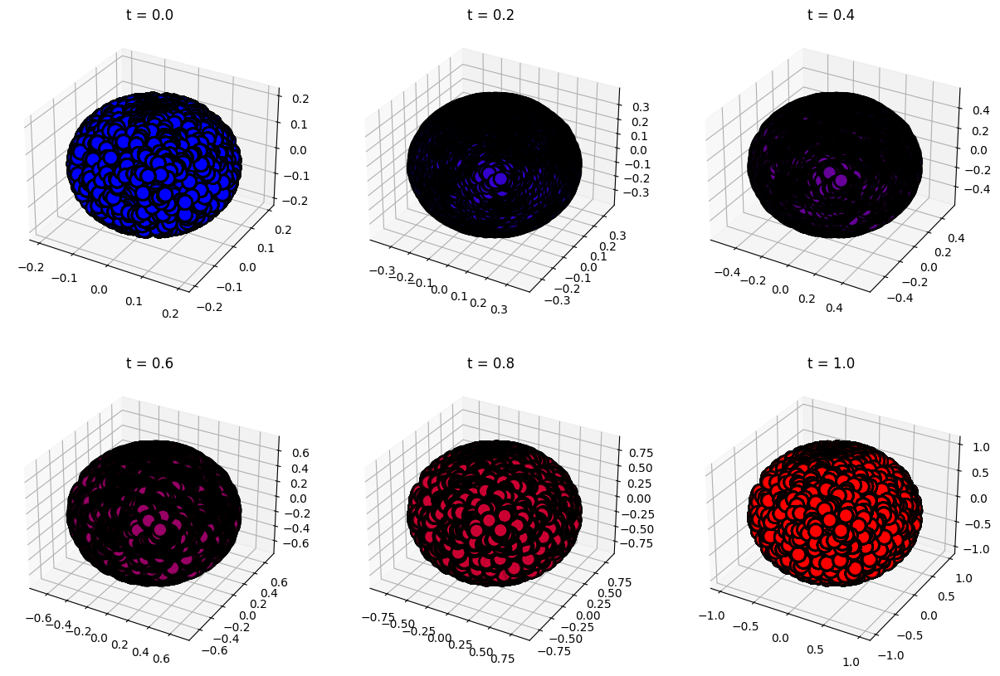

100%|██████████| 4/4 [00:01<00:00,  3.98it/s]


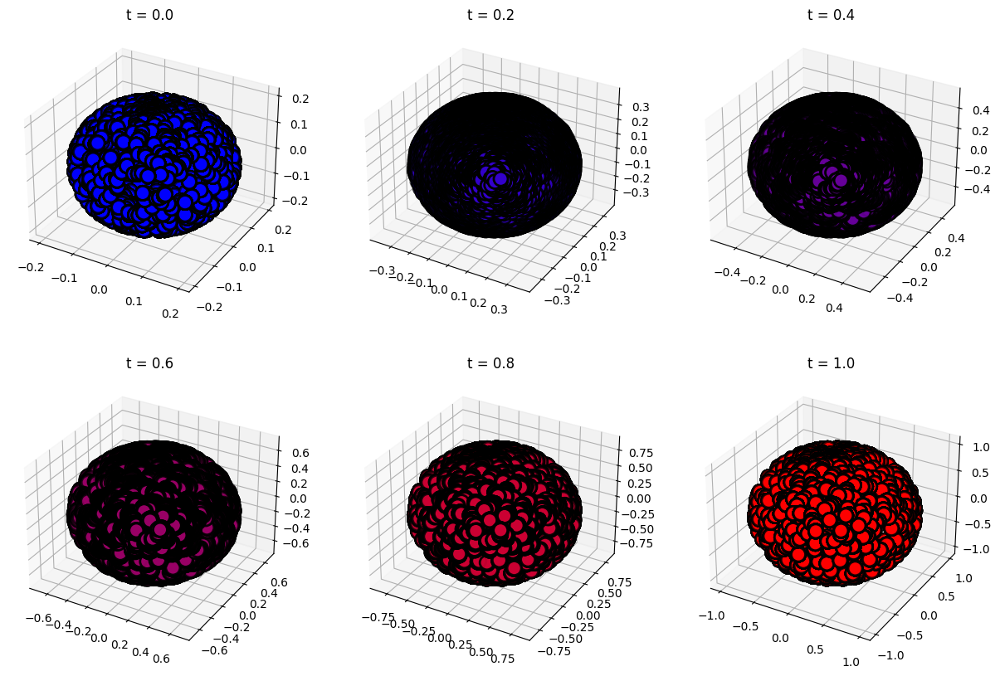

100%|██████████| 1/1 [00:00<00:00,  1.07it/s]


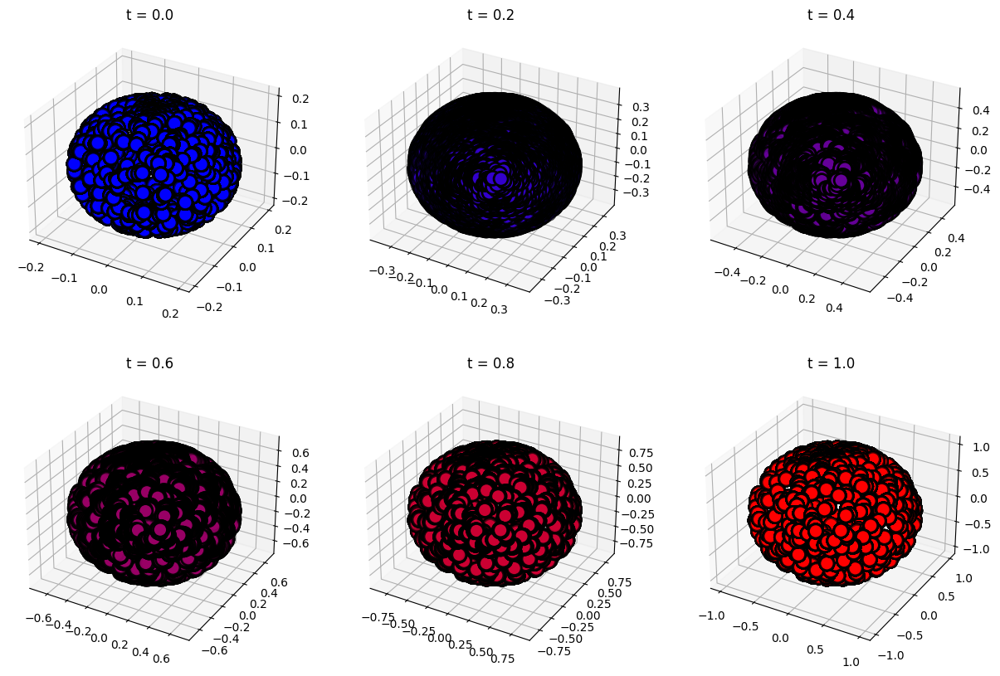

In [ ]:
m_list = [n//4, n//2, 3*n//4]
for m in m_list:
  k = int((n/m)**2)
  P = get_subsampled_mbtp(alpha, beta, m, k)
  displacement_interpolation_3d(P, alpha, beta, path=f'inter_ball_{n}_{m}_{k}.png')

100%|██████████| 100/100 [00:00<00:00, 626.83it/s]


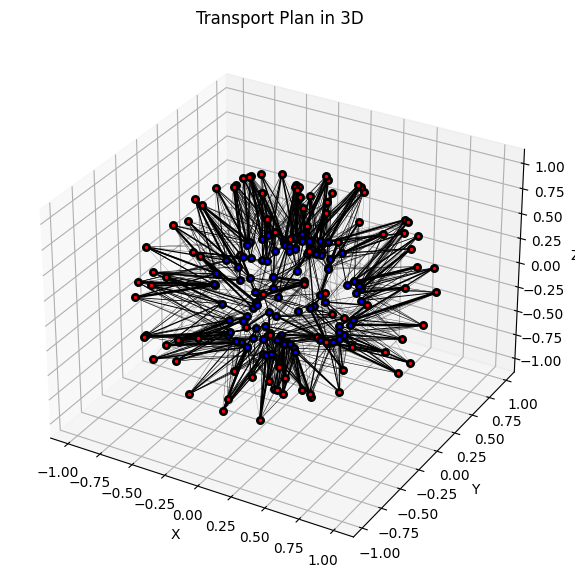

In [ ]:
m = n//2
k = 100
sub_mbtp = get_subsampled_mbtp(alpha, beta, m, k)
plot_transport_plan_3d(sub_mbtp, alpha, beta)

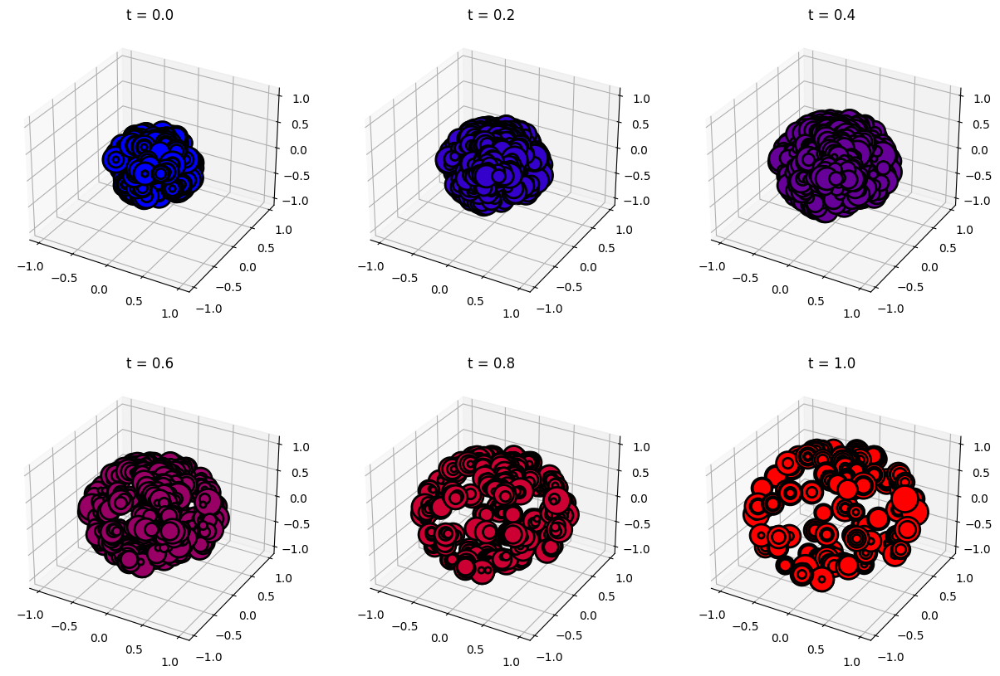

In [ ]:
displacement_interpolation_3d(sub_mbtp, alpha, beta)

## Set 2

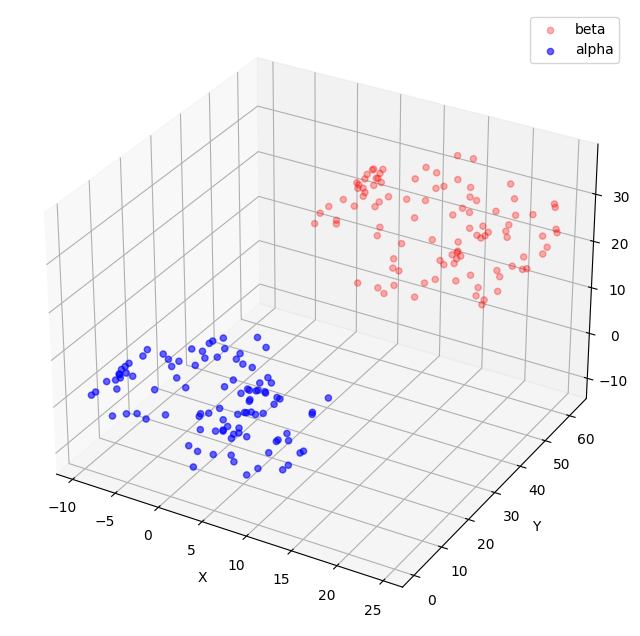

In [ ]:
n = 100
alpha, _ = make_swiss_roll(n)
beta, _ = make_swiss_roll(n)
beta = beta + np.array([12, 42, 23])
plot_datapoints_3d(alpha, beta)

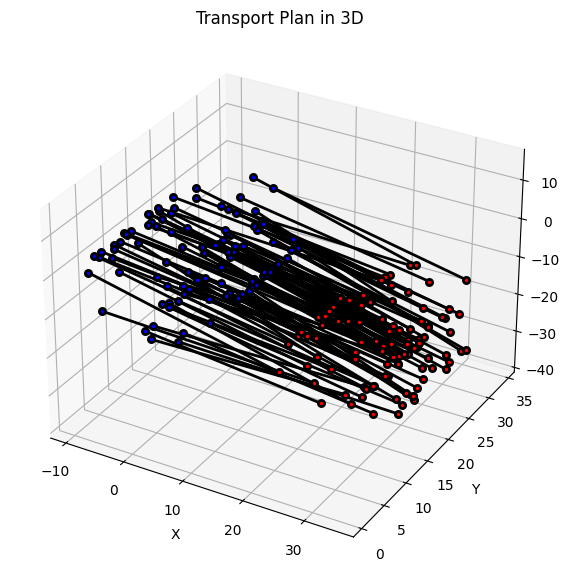

In [ ]:
tp = ot.emd([], [], ot.dist(alpha, beta))
plot_transport_plan_3d(tp, alpha, beta)

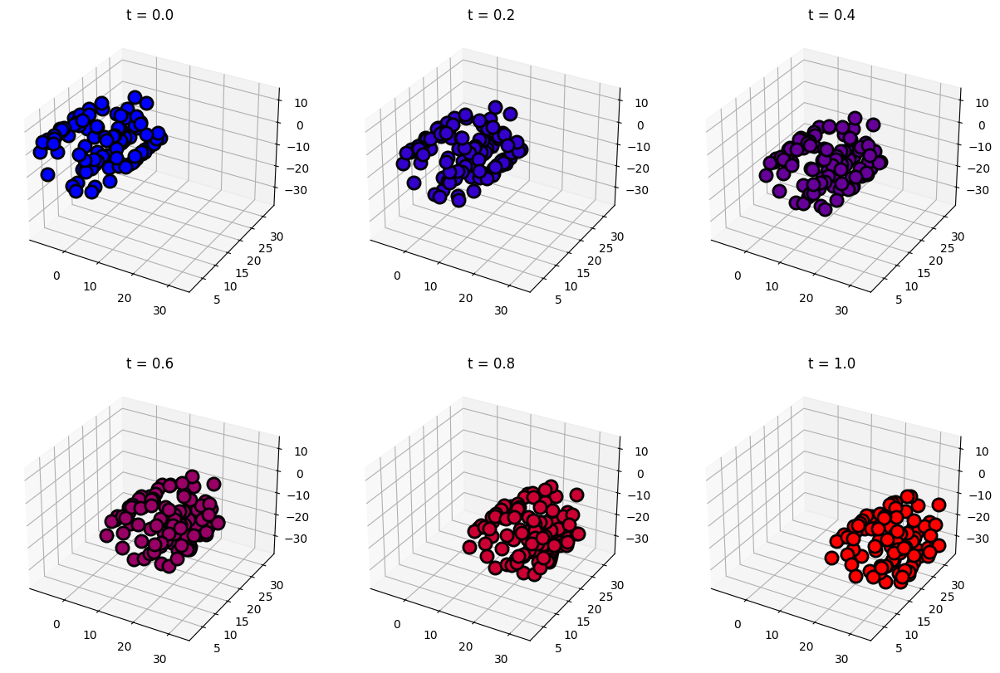

In [ ]:
displacement_interpolation_3d(tp, alpha, beta)

100%|██████████| 10/10 [00:00<00:00, 528.63it/s]


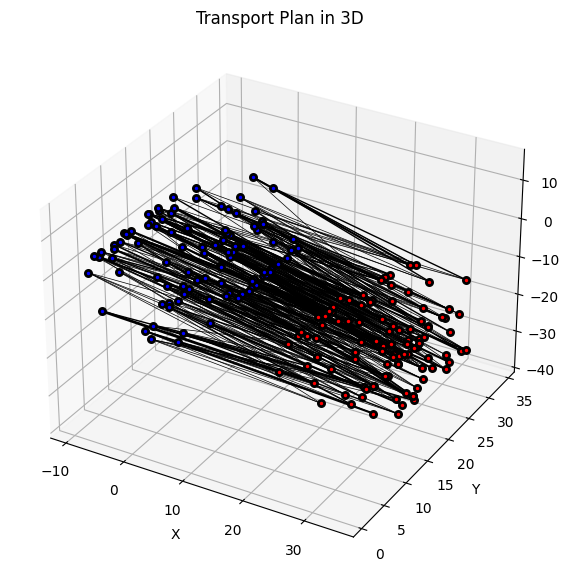

In [ ]:
m = 50
k = 10
sub_mbtp = get_subsampled_mbtp(alpha, beta, m, k)
plot_transport_plan_3d(sub_mbtp, alpha, beta)

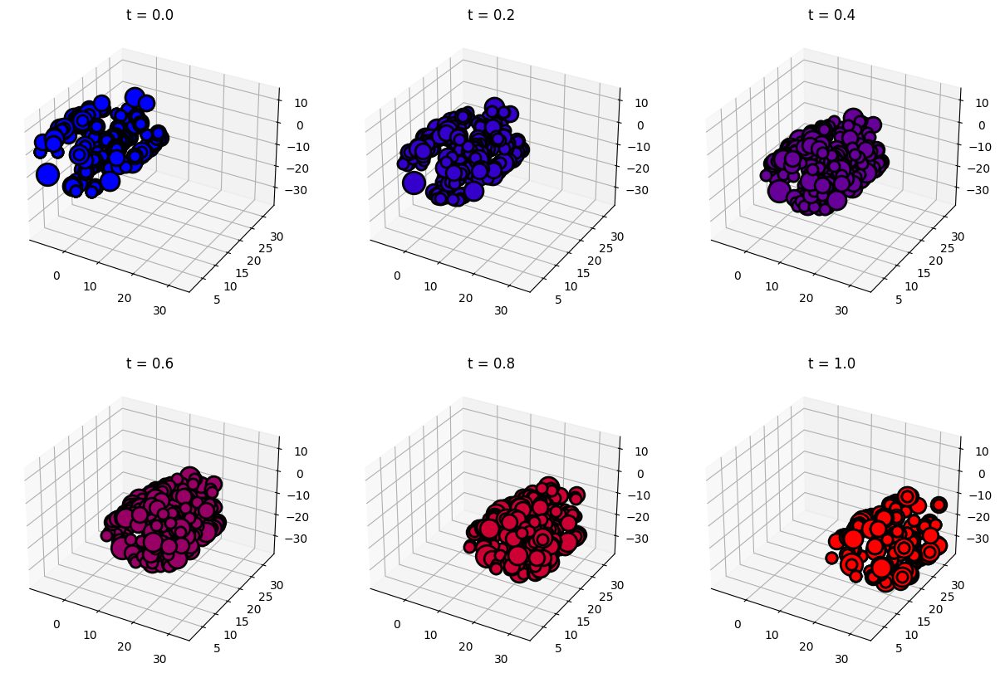

In [ ]:
displacement_interpolation_3d(sub_mbtp, alpha, beta)

In [ ]:
k_lists = [10**i for i in range(6)]
for k in k_lists:
  sub_mbtp = get_subsampled_mbtp(alpha, beta, m, k)
  _, _, err = get_marginal_error(sub_mbtp)
  print(f'With k={k}, we obtain a marginal error of {err}')

100%|██████████| 1/1 [00:00<00:00, 354.61it/s]


With k=1, we obtain a marginal error of 1.9999999999999998


100%|██████████| 10/10 [00:00<00:00, 678.10it/s]


With k=10, we obtain a marginal error of 0.4760000000000001


100%|██████████| 100/100 [00:00<00:00, 766.36it/s]


With k=100, we obtain a marginal error of 0.16519999999999999


100%|██████████| 1000/1000 [00:00<00:00, 1073.95it/s]


With k=1000, we obtain a marginal error of 0.04868000000000003


100%|██████████| 10000/10000 [00:09<00:00, 1000.01it/s]


With k=10000, we obtain a marginal error of 0.015164000000001128


100%|██████████| 100000/100000 [01:36<00:00, 1032.53it/s]

With k=100000, we obtain a marginal error of 0.004994400000013149


In [ ]:
k_lists = [10**i for i in range(6)]
for k in k_lists:
  sub_mbtp = get_subsampled_mbtp(alpha, beta, m, k)
  _, _, err = get_coupling_err(sub_mbtp, alpha, beta)
  print(f'With k={k}, we obtain a marginal error of {err}')

100%|██████████| 1/1 [00:00<00:00, 171.01it/s]


With k=1, we obtain a marginal error of 1775.933832504293


100%|██████████| 10/10 [00:00<00:00, 317.76it/s]


With k=10, we obtain a marginal error of 112.87375408814577


100%|██████████| 100/100 [00:00<00:00, 676.63it/s]


With k=100, we obtain a marginal error of 23.635292087199865


100%|██████████| 1000/1000 [00:01<00:00, 538.75it/s]


With k=1000, we obtain a marginal error of 17.15515977275726


100%|██████████| 10000/10000 [00:10<00:00, 973.63it/s]


With k=10000, we obtain a marginal error of 16.060665841978377


100%|██████████| 100000/100000 [01:37<00:00, 1023.78it/s]

With k=100000, we obtain a marginal error of 15.968257493313143


# High dimension (d=10)

100%|██████████| 2/2 [00:00<00:00, 319.08it/s]


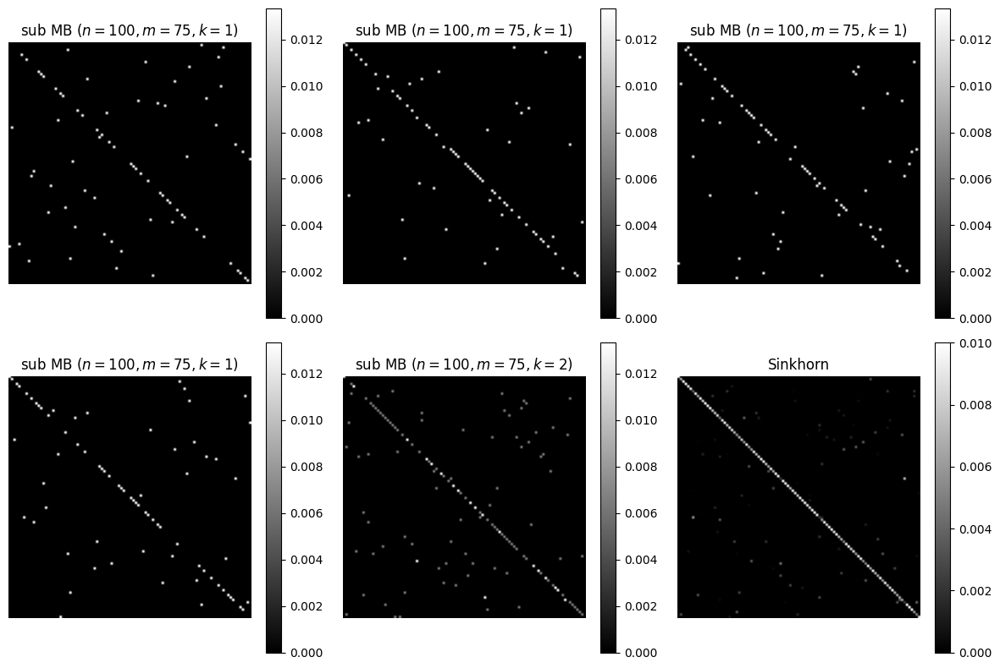

In [ ]:
n = 100
alpha, beta = uniform_dist(n, 10)
P = ot.emd([], [], ot.dist(alpha, beta))
I, J = np.nonzero(P > 1e-5)
beta = beta[J]

m = 3*n//4
k_max_emd = int((n/m)**3 * np.log(n)/np.log(m))
k_list = np.linspace(1, k_max_emd, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, k in enumerate(k_list):
    P = get_subsampled_mbtp(alpha, beta, m, k, h='emd')
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'sub MB ($n={n}, m={m}, k={k}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = sinkhorn(unif(n), unif(n), dist(alpha, beta))
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Sinkhorn')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'sub_mb_10d_emd_{n}_{m}.png')

100%|██████████| 17/17 [00:02<00:00,  6.72it/s]


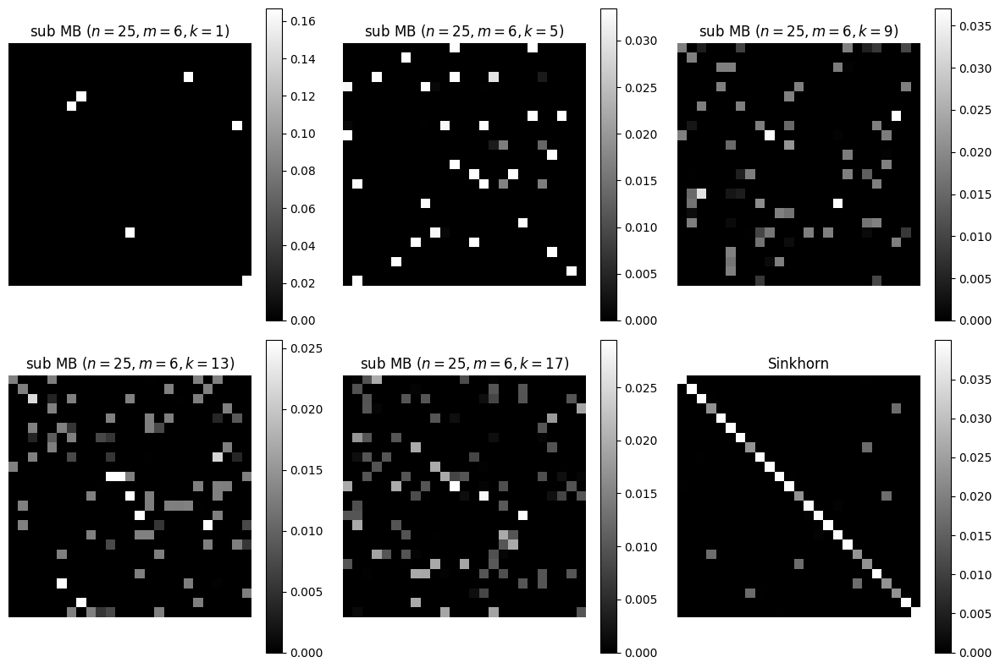

In [ ]:
n = 25
alpha, beta = uniform_dist(n, 10)
P = ot.emd([], [], ot.dist(alpha, beta))
I, J = np.nonzero(P > 1e-5)
beta = beta[J]

m = n//4
k_max_emd = int((n/m)**2)
k_list = np.linspace(1, k_max_emd, 5).astype(int)

# Création de la figure
num_plots = len(m_list) + 1
num_cols = 3  # Nombre de colonnes dans la grille
num_rows = -(-num_plots // num_cols)  # Calcul du nombre de lignes nécessaires

fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))

for i, k in enumerate(k_list):
    P = get_subsampled_mbtp(alpha, beta, m, k)
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.set_title(fr'sub MB ($n={n}, m={m}, k={k}$)')
    img = ax.imshow(P, cmap='gray')
    fig.colorbar(img, ax=ax)
    ax.axis('off')

P = sinkhorn(unif(n), unif(n), dist(alpha, beta))
row = (i+1) // num_cols
col = (i+1) % num_cols
ax = axs[row, col] if num_rows > 1 else axs[col]
ax.set_title(fr'Sinkhorn')
img = ax.imshow(P, cmap='gray')
fig.colorbar(img, ax=ax)
ax.axis('off')

# S'assurer que les sous-graphiques vides ne sont pas affichés
for i in range(len(m_list), num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col] if num_rows > 1 else axs[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

fig.savefig(f'sub_mb_10d_sink_{n}_{m}.png')